# 🦷 **Dental X-Ray Object Detection Pipeline**

These initial cells establish the foundation for our dental X-ray object detection system:

1. **Setup**: Install essential libraries for computer vision and deep learning (PyTorch, torchvision, etc.)
2. **Dataset Import**: Download the pre-annotated dental X-ray dataset from Roboflow in COCO format

* **Important**: You must replace the API key and project information with your
own
* Access the dataset at: https://universe.roboflow.com/arshs-workspace-radio/vzrad2
* After signing up, update the workspace, project name and API key in the code


3. **Preprocessing Pipeline**: The code then implements:

* Cleaning annotations by removing unwanted classes
* Merging similar dental feature classes
* Class-aware augmentation that applies stronger transformations to rare conditions and gentler ones to common features.


This approach ensures a balanced dataset for optimal model training on dental conditions. **Detailed comments throughout explain key techniques and implementation decisions.**

In [ ]:
 # Step 1: Install required packages
!pip install torch torchvision
!pip install pycocotools
!pip install matplotlib

# Step 2: Import Dataset from Roboflow
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key=" YOUR OWN KEY ") # REPLACE this with your OWN key with other info for your downloaded version .
project = rf.workspace("deemas-work").project("vzrad2-socyo")
version = project.version(4)
dataset = version.download("coco-segmentation")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 92.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 86.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 52.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 103.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitl


Extracting Dataset Version Zip to vzrad2-4 in coco-segmentation:: 100%|██████████| 10582/10582 [00:01<00:00, 5674.49it/s]


🔄 Force rebuilding all files for train
🔄 Cleaning train annotations...
✅ Cleaned train annotations saved
🔄 Remapping train annotations...

📊 Original Category Counts Before Remapping:
ID    Category Name                  Count     
--------------------------------------------------
1     Amalgam filling                560       
2     Bone Loss                      2904      
3     Caries                         5316      
4     Cavity                         510       
5     Composite filling              504       
6     Crown                          5848      
8     Filling                        20958     
9     Fillings                       4646      
10    Fracture teeth                 44        
11    Impacted Tooth                 328       
12    Implant                        2638      
14    Mandibular Canal               586       
15    Missing teeth                  2264      
16    Periapical lesion              3264      
17    Permanent Teeth                696     

ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.


  Progress: 50/72 augmentations for Maxillary Sinus
  Added 72 instances of class 25 (Maxillary Sinus)
Augmenting class 1 (abutment): current=128, target=500, need to add 372
  Progress: 50/372 augmentations for abutment
  Progress: 100/372 augmentations for abutment
  Progress: 300/372 augmentations for abutment
  Added 372 instances of class 1 (abutment)
Augmenting class 4 (post - core): current=462, target=500, need to add 38
  Added 38 instances of class 4 (post - core)
Augmenting class 15 (Fracture_teeth): current=48, target=500, need to add 452
  Progress: 50/452 augmentations for Fracture_teeth
  Progress: 100/452 augmentations for Fracture_teeth
  Progress: 200/452 augmentations for Fracture_teeth
  Progress: 350/452 augmentations for Fracture_teeth
  Progress: 400/452 augmentations for Fracture_teeth
  Progress: 450/452 augmentations for Fracture_teeth
  Added 452 instances of class 15 (Fracture_teeth)
Augmenting class 8 (orthodontic brackets): current=86, target=500, need to 

Argument(s) 'var_limit' are not valid for transform GaussNoise


  Progress: 50/490 augmentations for decay
  Progress: 100/490 augmentations for decay
  Progress: 150/490 augmentations for decay
  Progress: 200/490 augmentations for decay
  Progress: 250/490 augmentations for decay
  Progress: 300/490 augmentations for decay
  Progress: 350/490 augmentations for decay
  Progress: 400/490 augmentations for decay
  Progress: 450/490 augmentations for decay
  Added 490 instances of class 10 (decay)
Augmenting class 32 (treated plates and screws for fracture of bones): current=12, target=500, need to add 488
  Progress: 50/488 augmentations for treated plates and screws for fracture of bones
  Progress: 100/488 augmentations for treated plates and screws for fracture of bones
  Progress: 150/488 augmentations for treated plates and screws for fracture of bones
  Progress: 200/488 augmentations for treated plates and screws for fracture of bones
  Progress: 250/488 augmentations for treated plates and screws for fracture of bones
  Progress: 300/488 aug

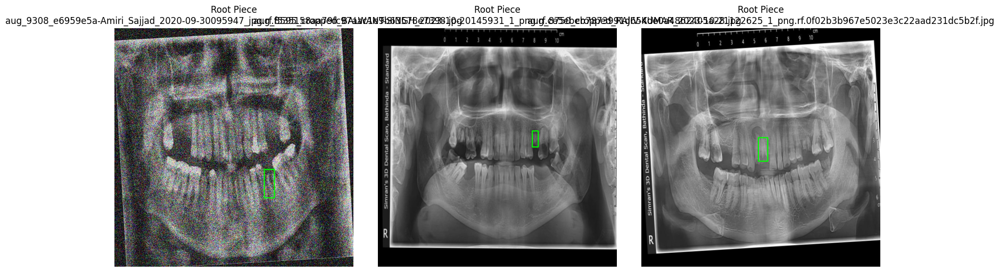


📊 Displaying samples for class: Bone Loss (ID: 23.0)
Found 2659 augmented instances


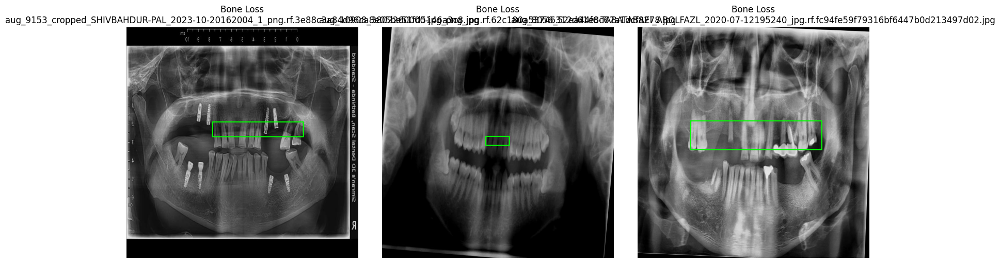


📊 Displaying samples for class: Mandibular Canal (ID: 24.0)
Found 192 augmented instances


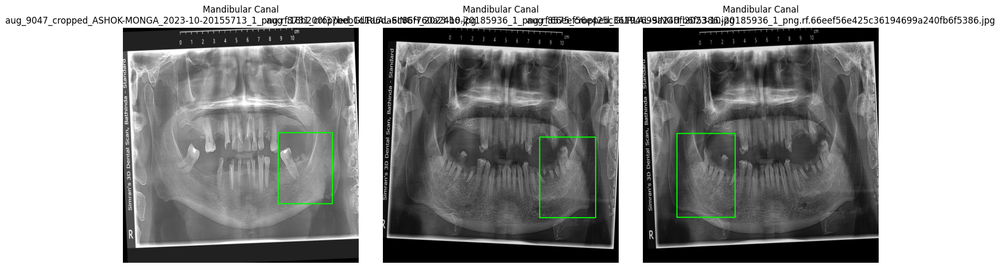


📊 Displaying samples for class: Maxillary Sinus (ID: 25.0)
Found 176 augmented instances


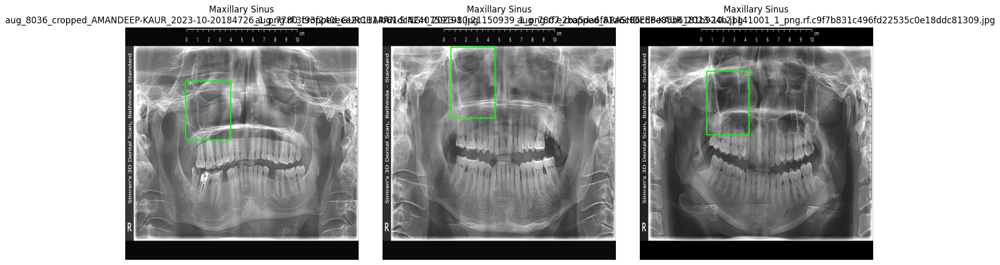


📊 Displaying samples for class: Fillings (ID: 12.0)
Found 5141 augmented instances


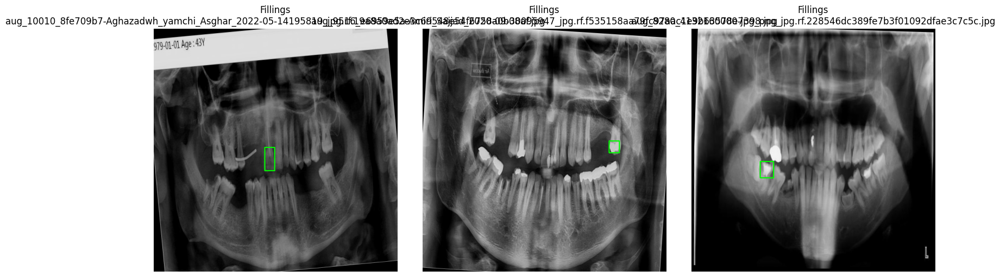


📊 Displaying samples for class: Crown (ID: 3.0)
Found 1942 augmented instances


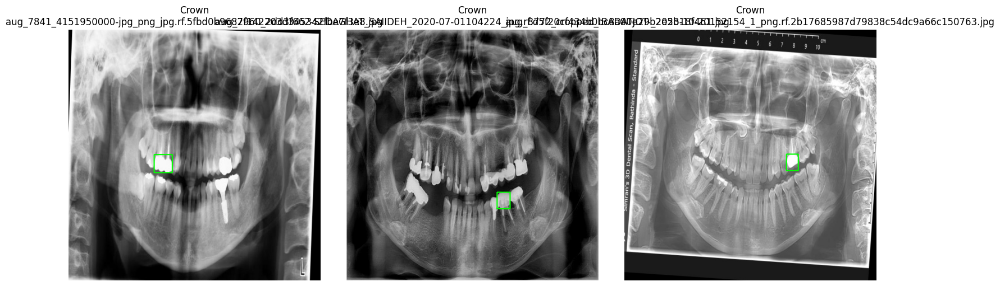


📊 Displaying samples for class: Root_canal_treatment (ID: 17.0)
Found 4482 augmented instances


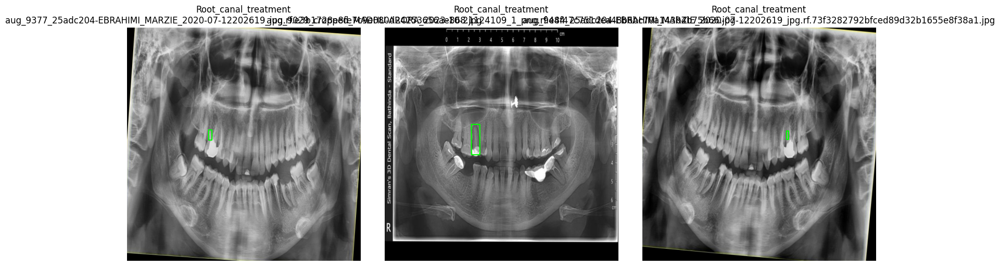


📊 Displaying samples for class: Impacted_teeth (ID: 16.0)
Found 3306 augmented instances


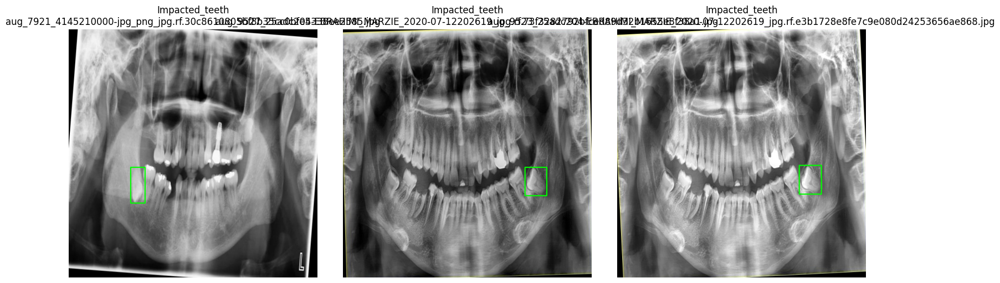


📊 Displaying samples for class: Implant (ID: 22.0)
Found 809 augmented instances


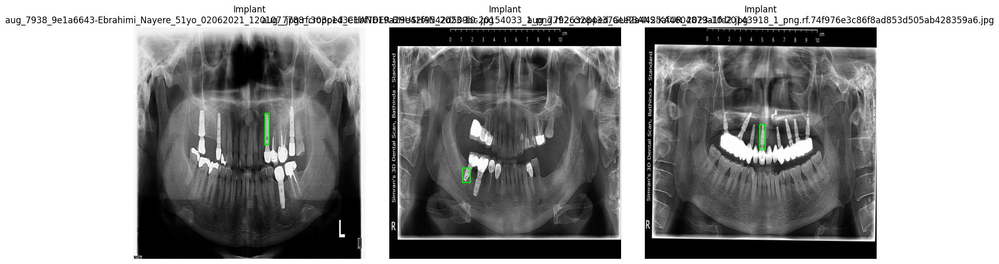


📊 Displaying samples for class: Periapical lesion (ID: 29.0)
Found 3935 augmented instances


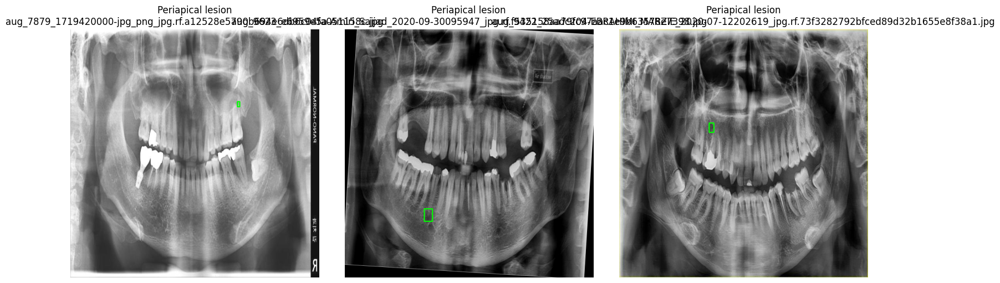


📊 Displaying samples for class: abutment (ID: 1.0)
Found 376 augmented instances


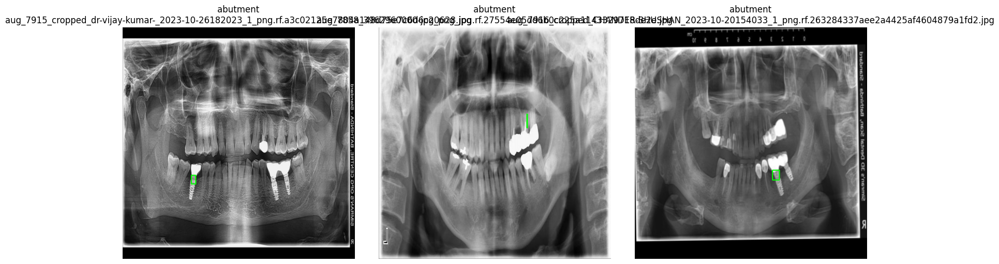


📊 Displaying samples for class: Missing teeth (ID: 28.0)
Found 2569 augmented instances


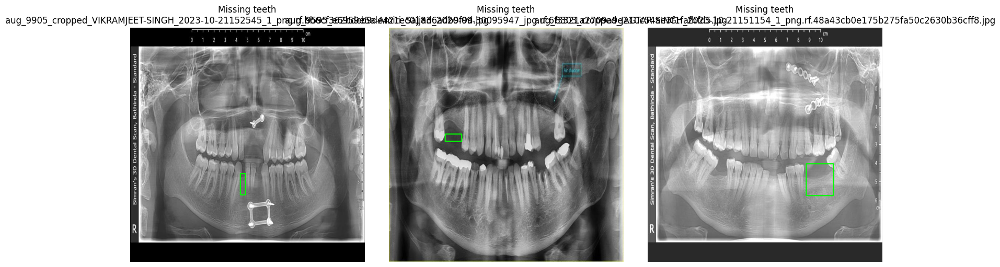


📊 Displaying samples for class: Caries (ID: 9.0)
Found 7744 augmented instances


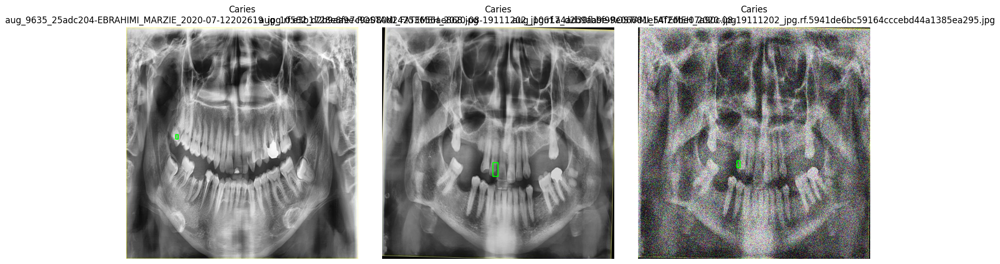


📊 Displaying samples for class: Spacing (ID: 31.0)
Found 471 augmented instances


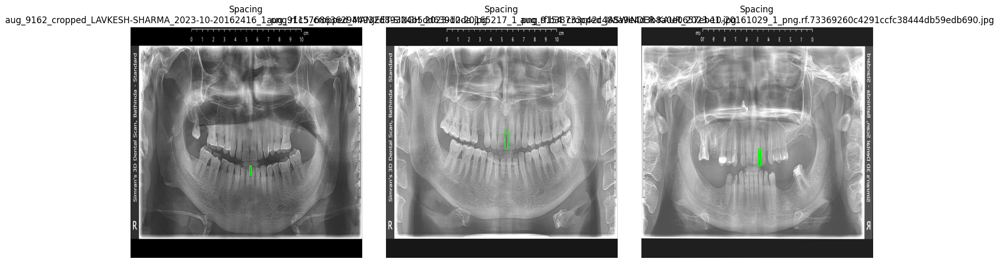


📊 Displaying samples for class: post - core (ID: 4.0)
Found 170 augmented instances


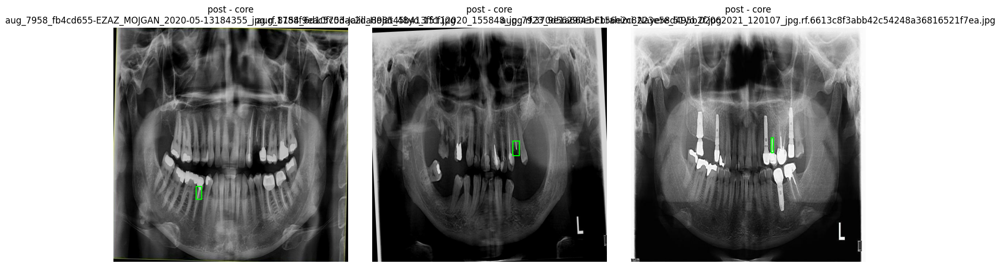


📊 Displaying samples for class: Amalgam filling (ID: 14.0)
Found 266 augmented instances


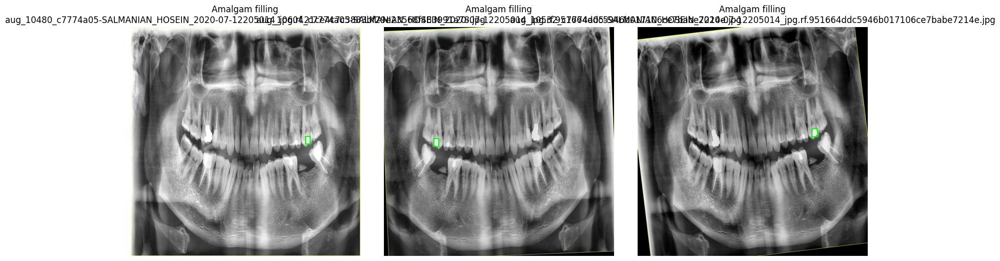


📊 Displaying samples for class: Composite filling (ID: 13.0)
Found 422 augmented instances


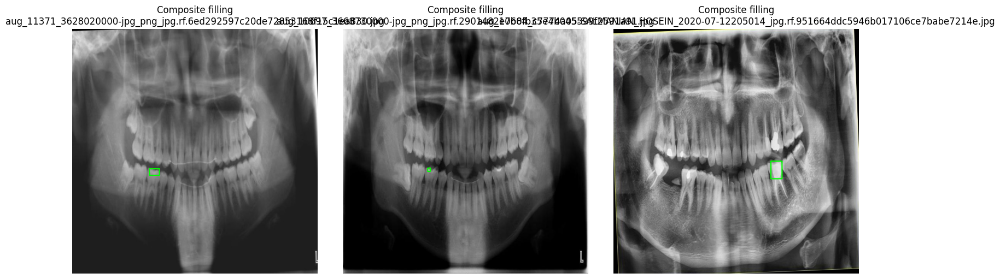


📊 Displaying samples for class: Fracture_teeth (ID: 15.0)
Found 622 augmented instances


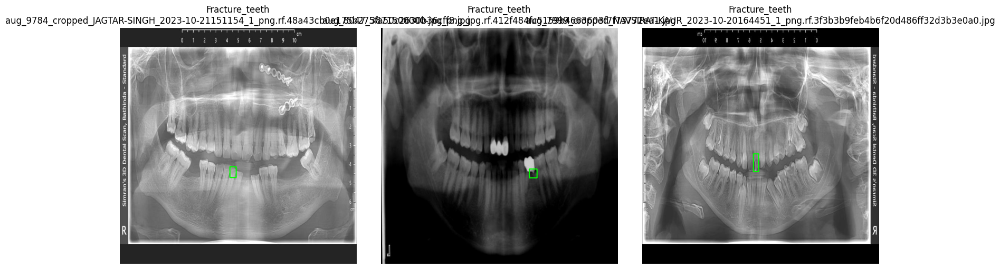


📊 Displaying samples for class: treated plates and screws for fracture of bones (ID: 32.0)
Found 576 augmented instances


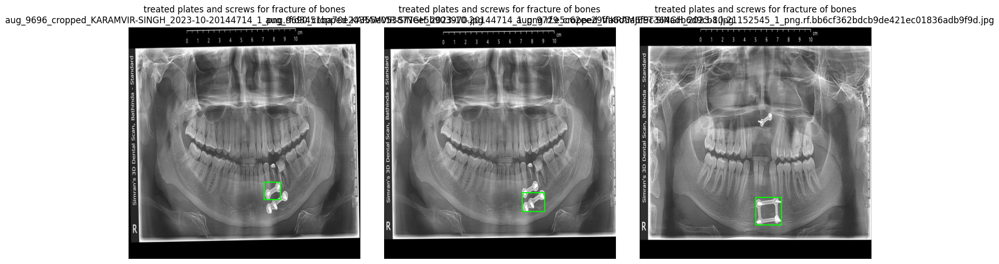


📊 Displaying samples for class: Primary teeth (ID: 27.0)
Found 449 augmented instances


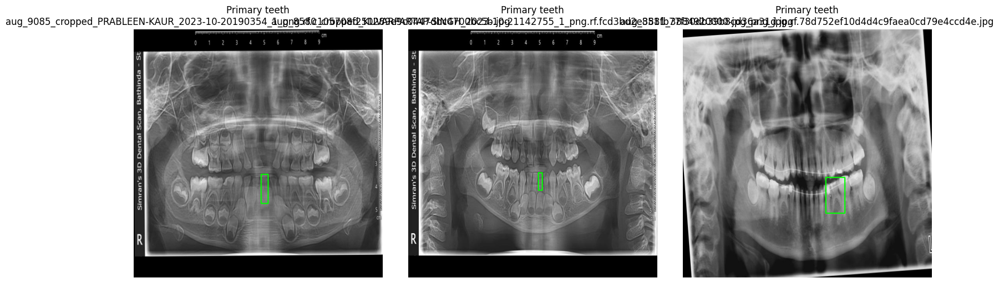


📊 Displaying samples for class: orthodontic brackets (ID: 8.0)
Found 422 augmented instances


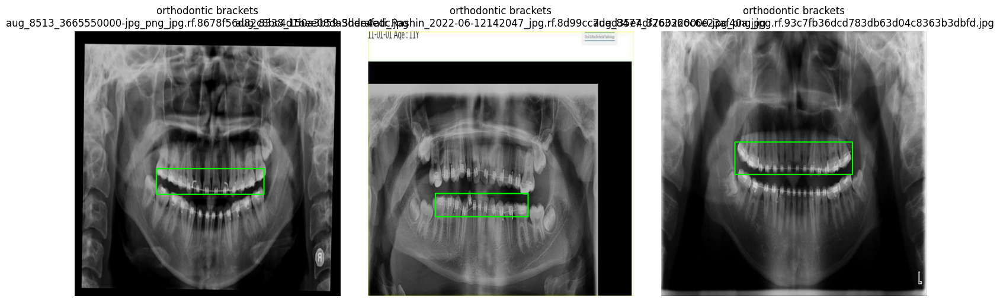


📊 Displaying samples for class: Wire (ID: 21.0)
Found 325 augmented instances


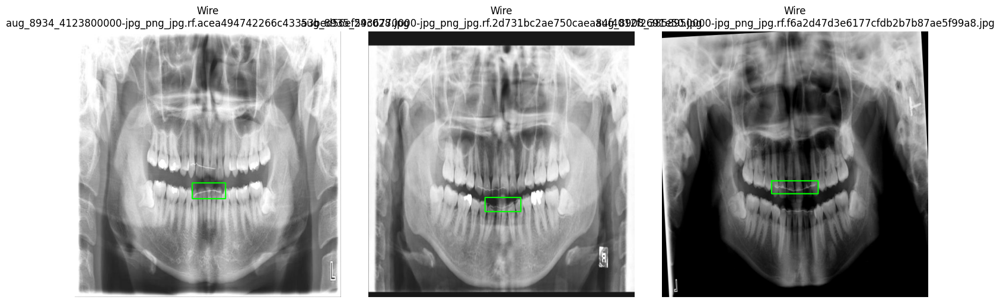


📊 Displaying samples for class: Permanent Teeth (ID: 26.0)
Found 326 augmented instances


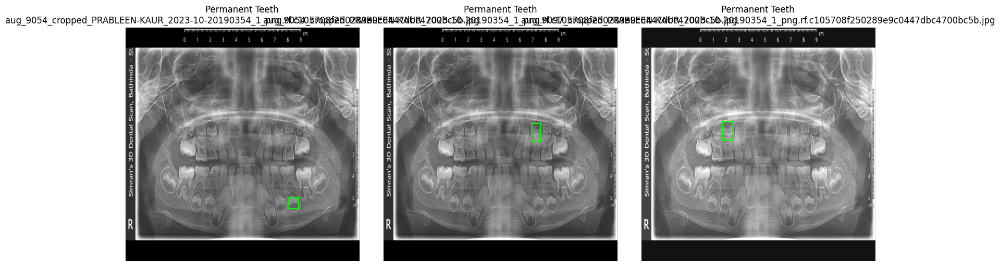


📊 Displaying samples for class: deep decay (ID: 11.0)
Found 446 augmented instances


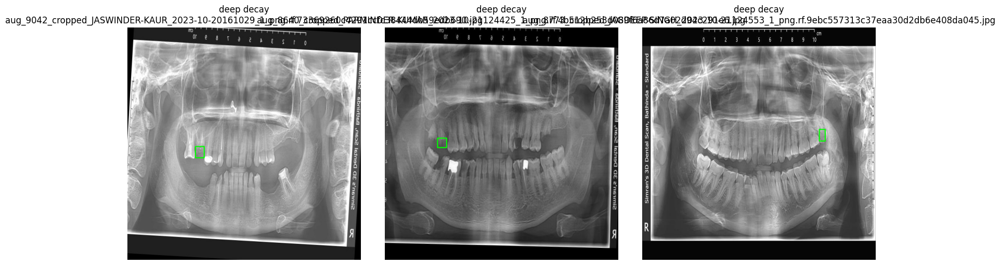


📊 Displaying samples for class: decay (ID: 10.0)
Found 490 augmented instances


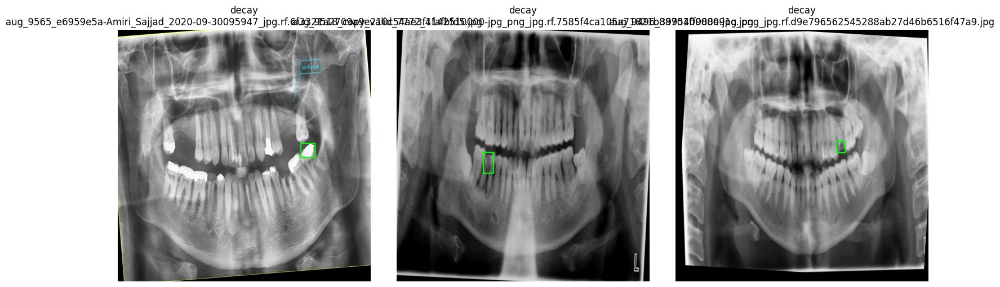


📊 Displaying samples for class: metal band (ID: 6.0)
Found 490 augmented instances


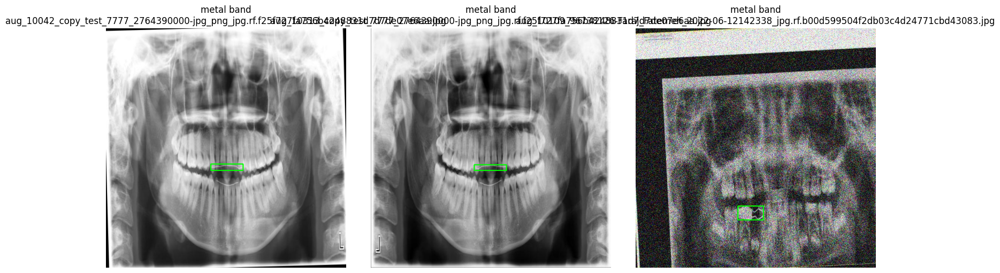


📊 Displaying samples for class: Retained root (ID: 19.0)
Found 479 augmented instances


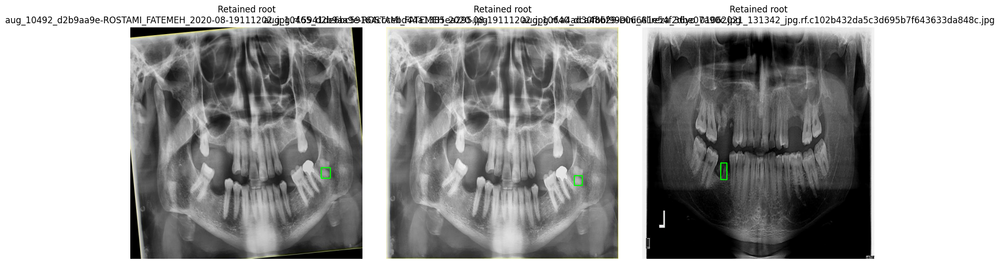


📊 Displaying samples for class: Supra Eruption (ID: 30.0)
Found 484 augmented instances


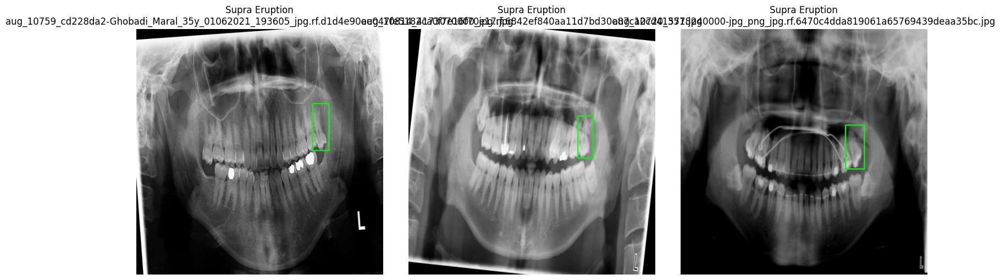


📊 Displaying samples for class: permanentretainer (ID: 7.0)
Found 491 augmented instances


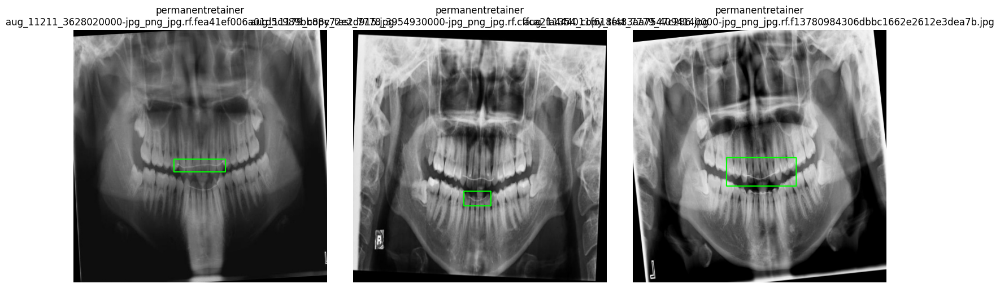

✅ Visualization complete!


In [ ]:
import os
import json
import cv2
import albumentations as A
import random
from collections import defaultdict
import shutil

def create_modified_augmentations(class_name=None):
    """
    Returns class-specific augmentation strategies based on class needs
    with more conservative parameters for dental X-rays
    """
    import albumentations as A

    # For extremely rare classes (< 50 samples), use more controlled augmentation
    rare_classes = ["metal band", "decay", "permanentretainer", "Plating", "Supra Eruption", "Retained root"]

    # For uncommon classes (50-200 samples), use moderate augmentation
    uncommon_classes = ["Fracture teeth", "orthodontic brackets", "Spacing", "abutment", "deep decay"]

    # For somewhat represented classes (200-500 samples), use gentler augmentation
    moderate_classes = ["Wire", "Maxillary Sinus", "post - core"]

    if class_name in rare_classes:
        return A.Compose([
            A.HorizontalFlip(p=0.5),
            A.RandomBrightnessContrast(brightness_limit=0.12, contrast_limit=0.12, p=0.4),  # Reduced from 0.15
            A.Rotate(limit=7, p=0.5),  # Keeping at 7 degrees
            A.ShiftScaleRotate(shift_limit=0.02, scale_limit=0.05, rotate_limit=5, p=0.3),  # Reduced parameters
            A.GaussianBlur(blur_limit=(1, 2), p=0.15),  # Reduced probability from 0.2
            A.GaussNoise(var_limit = 5.0 ,p=0.1),  # Reduced probability from 0.2 and using default values
        ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

    elif class_name in uncommon_classes:
        return A.Compose([
            A.HorizontalFlip(p=0.4),
            A.RandomBrightnessContrast(brightness_limit=0.10, contrast_limit=0.10, p=0.3),  # Reduced from 0.12
            A.Rotate(limit=5, p=0.4),
            A.ShiftScaleRotate(shift_limit=0.02, scale_limit=0.04, rotate_limit=3, p=0.3),  # Reduced rotation
            A.GaussianBlur(blur_limit=(1, 2), p=0.1),
        ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

    elif class_name in moderate_classes:
        return A.Compose([
            A.HorizontalFlip(p=0.3),
            A.RandomBrightnessContrast(brightness_limit=0.08, contrast_limit=0.08, p=0.3),
            A.Rotate(limit=5, p=0.3),
            A.ShiftScaleRotate(shift_limit=0.02, scale_limit=0.04, rotate_limit=3, p=0.2),
        ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

    else:
        # Default augmentation for well-represented classes
        return A.Compose([
            A.HorizontalFlip(p=0.3),
            A.RandomBrightnessContrast(brightness_limit=0.08, contrast_limit=0.08, p=0.2),
            A.Rotate(limit=3, p=0.2),
            A.ShiftScaleRotate(shift_limit=0.01, scale_limit=0.02, rotate_limit=2, p=0.2),
        ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

def full_pipeline(force_rebuild=True):
    # 1. Define paths
    dataset_path = "/content/vzrad2-4"
    splits = ["train", "valid", "test"]

    # 2. Clean and merge for all splits
    for split in splits:
        original_ann = os.path.join(dataset_path, split, "_annotations.coco.json")
        cleaned_ann = os.path.join(dataset_path, split, "_annotations_cleaned.json")
        remapped_ann = os.path.join(dataset_path, split, "_annotations_remapped.json")
        merged_ann = os.path.join(dataset_path, split, "_annotations_merged.json")

        # Force rebuild if requested
        if force_rebuild:
            print(f"🔄 Force rebuilding all files for {split}")
            if os.path.exists(cleaned_ann):
                os.remove(cleaned_ann)
            if os.path.exists(remapped_ann):
                os.remove(remapped_ann)
            if os.path.exists(merged_ann):
                os.remove(merged_ann)

        # Clean step - Only drop specifically unwanted classes
        if not os.path.exists(cleaned_ann):
            print(f"🔄 Cleaning {split} annotations...")
            try:
                # Load original data
                with open(original_ann, 'r') as f:
                    data = json.load(f)

                # Define classes to drop
                classes_to_drop = [
                    "vzrad2",
                    "Cyst",
                    "Root resorption",
                    "TAD",
                    "Unhealed socket",
                    "attrition",
                    "bone defect",
                    "dee",
                    "distoangular third molar impaction",
                    "fracture line",
                    "gingival former",
                    "horizontal third molar impaction",
                    "inter maxillary fixation",
                    "mesioangularthird molar impaction",
                    "vertical third molar impaction",
                    "Malaligned",
                    "plating"
                ]

                if classes_to_drop:
                    # Map category names to IDs for easier lookup
                    category_name_to_id = {c['name']: c['id'] for c in data['categories']}

                    # Find IDs of categories to drop
                    drop_ids = [category_name_to_id[name] for name in classes_to_drop if name in category_name_to_id]

                    # Remove categories
                    data['categories'] = [c for c in data['categories'] if c['name'] not in classes_to_drop]

                    # Remove annotations for dropped categories
                    data['annotations'] = [ann for ann in data['annotations'] if ann['category_id'] not in drop_ids]

                # Save cleaned data
                with open(cleaned_ann, 'w') as f:
                    json.dump(data, f)
                print(f"✅ Cleaned {split} annotations saved")

            except Exception as e:
                print(f"❌ Cleaning failed for {split}: {str(e)}")
                return

        # New Remapping step with improved tracking
        if not os.path.exists(remapped_ann) and os.path.exists(cleaned_ann):
            print(f"🔄 Remapping {split} annotations...")
            try:
                # Load cleaned data
                with open(cleaned_ann, 'r') as f:
                    data = json.load(f)

                # First, count original annotations per category
                original_counts = defaultdict(int)
                for ann in data['annotations']:
                    original_counts[ann['category_id']] += 1

                # Create category name and ID mappings
                original_cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}

                print("\n📊 Original Category Counts Before Remapping:")
                print("{:<5} {:<30} {:<10}".format('ID', 'Category Name', 'Count'))
                print("-" * 50)
                for cat_id, count in sorted(original_counts.items()):
                    cat_name = original_cat_id_to_name.get(cat_id, "Unknown")
                    print(f"{cat_id:<5} {cat_name:<30} {count:<10}")

                # Define remapping for class names
                class_name_remapping = {
                    # Classes to remap
                    "Cavity": "Caries",
                    "cavity": "Caries",
                    "Filling": "Fillings",
                    "Impacted Tooth": "Impacted teeth",
                    "Root canal filling": "root canal treatment",
                    "Root canal obturation": "root canal treatment",
                    "braces": "orthodontic brackets",
                    "croen": "Crown",
                    "fracture tooth": "Fracture teeth",
                    "impacted canine": "Impacted teeth",
                    "impacted premoalr": "Impacted teeth",
                    "impacted tooth": "Impacted teeth",
                    "interdental wire": "wire",
                    "rct": "root canal treatment",
                }

                # Create tracking for remapped classes to see where annotations go
                remapping_tracker = {}
                for cat in data['categories']:
                    if cat['name'] in class_name_remapping:
                        target = class_name_remapping[cat['name']]
                        if target not in remapping_tracker:
                            remapping_tracker[target] = []
                        remapping_tracker[target].append({
                            'source_name': cat['name'],
                            'source_id': cat['id'],
                            'count': original_counts.get(cat['id'], 0)
                        })

                # Print remapping plan
                print("\n📋 Remapping Plan:")
                for target, sources in remapping_tracker.items():
                    total = sum(src['count'] for src in sources)
                    print(f"→ {target} (Total: {total} annotations)")
                    for src in sources:
                        print(f"  - {src['source_name']} (ID: {src['source_id']}): {src['count']} annotations")

                # Create mappings for categories
                cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
                cat_name_to_id = {cat['name']: cat['id'] for cat in data['categories']}

                # Track new categories we'll need to create
                new_categories = {}
                categories_to_remap = {}

                # Process each category for remapping
                for cat in data['categories']:
                    if cat['name'] in class_name_remapping:
                        target_name = class_name_remapping[cat['name']]

                        # Check if target category already exists
                        if target_name in cat_name_to_id:
                            # Target exists, map to existing ID
                            categories_to_remap[cat['id']] = cat_name_to_id[target_name]
                        else:
                            # Target doesn't exist, we'll need to create it
                            if target_name not in new_categories:
                                # Create a new category with this name
                                new_id = max([c['id'] for c in data['categories']]) + len(new_categories) + 1
                                new_categories[target_name] = {
                                    'id': new_id,
                                    'name': target_name,
                                    'supercategory': cat.get('supercategory', 'dental')
                                }

                            # Map to the new category
                            categories_to_remap[cat['id']] = new_categories[target_name]['id']

                # Add new categories
                for cat_info in new_categories.values():
                    data['categories'].append(cat_info)
                    cat_name_to_id[cat_info['name']] = cat_info['id']

                print(f"✅ Created {len(new_categories)} new categories")

                # Create a mapping to track which annotations are remapped and where they go
                remap_tracking = defaultdict(int)
                orig_count_per_target = defaultdict(int)

                # Update annotations with remapped categories
                remapped_count = 0
                for ann in data['annotations']:
                    orig_cat_id = ann['category_id']
                    orig_cat_name = original_cat_id_to_name.get(orig_cat_id, "Unknown")

                    if orig_cat_id in categories_to_remap:
                        new_cat_id = categories_to_remap[orig_cat_id]
                        new_cat_name = "Unknown"

                        # Find the name of the new category
                        for cat in data['categories']:
                            if cat['id'] == new_cat_id:
                                new_cat_name = cat['name']
                                break

                        # Create a tracking key
                        track_key = f"{orig_cat_name} → {new_cat_name}"
                        remap_tracking[track_key] += 1
                        orig_count_per_target[new_cat_name] += 1

                        # Update the annotation
                        ann['category_id'] = new_cat_id
                        remapped_count += 1

                print(f"✅ Remapped {remapped_count} annotations")

                # Print detailed remapping results
                print("\n📊 Detailed Remapping Results:")
                for mapping, count in sorted(remap_tracking.items()):
                    print(f"{mapping}: {count} annotations")

                # Now remove categories that were remapped as they're no longer needed
                remapped_cat_ids = set(categories_to_remap.keys())
                data['categories'] = [cat for cat in data['categories'] if cat['id'] not in remapped_cat_ids]

                print(f"✅ Removed {len(remapped_cat_ids)} categories that were remapped")
                print(f"✅ Final category count: {len(data['categories'])}")

                # Calculate final annotation counts
                final_counts = defaultdict(int)
                for ann in data['annotations']:
                    final_counts[ann['category_id']] += 1

                # Create final category name mapping
                final_cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}

                # Print the categories that remain for verification
                print("\n📊 Final Category Counts After Remapping:")
                print("{:<5} {:<30} {:<10} {:<20}".format('ID', 'Category Name', 'Count', 'Original Combined'))
                print("-" * 70)
                for cat_id, count in sorted(final_counts.items()):
                    cat_name = final_cat_id_to_name.get(cat_id, "Unknown")

                    # Calculate original combined count
                    original_combined = 0
                    if cat_name in remapping_tracker:
                        # This was a target of remapping
                        original_combined = sum(src['count'] for src in remapping_tracker[cat_name])
                    else:
                        # This wasn't remapped
                        original_combined = original_counts.get(cat_id, 0)

                    print(f"{cat_id:<5} {cat_name:<30} {count:<10} {original_combined:<20}")

                # Save remapped data
                with open(remapped_ann, 'w') as f:
                    json.dump(data, f)
                print(f"✅ Remapped {split} annotations saved")

            except Exception as e:
                print(f"❌ Remapping failed for {split}: {str(e)}")
                import traceback
                traceback.print_exc()
                return

        # Merging step - Now uses remapped data as input
        source_for_merge = remapped_ann if os.path.exists(remapped_ann) else cleaned_ann

        if not os.path.exists(merged_ann):
            print(f"🔄 Merging {split} annotations...")
            try:
                with open(source_for_merge, 'r') as f:
                    data = json.load(f)

                # Define hierarchical class structure with updated classes
                hierarchical_structure = {
                    "Prosthodontics": {
                        "synonyms": [],
                        "subclasses": {
                            "abutment": ["abutment"],
                            "bridge": ["bridge"],
                            "Crown": ["Crown"],
                            "post - core": ["post - core"]
                        }
                    },
                    "Orthodontic_appliance": {
                        "synonyms": [],
                        "subclasses": {
                            "metal band": ["metal band"],
                            "permanentretainer": ["permanentretainer"],
                            "orthodontic brackets": ["orthodontic brackets"]
                        }
                    },
                    "Caries": {
                        "synonyms": ["Caries"],
                        "subclasses": {
                            "decay": ["decay"],
                            "deep decay": ["deep decay"]
                        }
                    },
                    "Fillings": {
                        "synonyms": ["Fillings"],
                        "subclasses": {
                            "Composite filling": ["Composite filling"],
                            "Amalgam filling": ["Amalgam filling"]
                        }
                    },
                    "Fracture_teeth": {
                        "synonyms": ["Fracture teeth"],
                        "subclasses": {}
                    },
                    "Impacted_teeth": {
                        "synonyms": ["Impacted teeth"],
                        "subclasses": {}
                    },
                    "Root_canal_treatment": {
                        "synonyms": ["root canal treatment"],
                        "subclasses": {}
                    },
                    "Remaining_root": {
                        "synonyms": [],
                        "subclasses": {
                            "Retained root": ["Retained root"],
                            "Root Piece": ["Root Piece"]
                        }
                    },
                    "Wire": {
                        "synonyms": ["wire"],
                        "subclasses": {}
                    },
                    "Implant": {
                        "synonyms": ["Implant"],
                        "subclasses": {}
                    },
                    "Bone Loss": {
                        "synonyms": ["Bone Loss"],
                        "subclasses": {}
                    },
                    "Mandibular Canal": {
                        "synonyms": ["Mandibular Canal"],
                        "subclasses": {}
                    },
                    "Maxillary Sinus": {
                        "synonyms": ["maxillary sinus"],
                        "subclasses": {}
                    },
                    "Permanent Teeth": {
                        "synonyms": ["Permanent Teeth"],
                        "subclasses": {}
                    },
                    "Primary teeth": {
                        "synonyms": ["Primary teeth"],
                        "subclasses": {}
                    },
                    "Missing teeth": {
                        "synonyms": ["Missing teeth"],
                        "subclasses": {}
                    },
                    "Periapical lesion": {
                        "synonyms": ["Periapical lesion"],
                        "subclasses": {}
                    },
                    "Supra Eruption": {
                        "synonyms": ["Supra Eruption"],
                        "subclasses": {}
                    },
                    "Spacing": {
                        "synonyms": ["spacing"],
                        "subclasses": {}
                    }
                }

                # For backward compatibility, create a flat merge_mapping
                merge_mapping = {}
                for main_class, details in hierarchical_structure.items():
                    # Start with all synonyms of the main class
                    all_terms = details["synonyms"].copy()

                    # Add all subclass terms
                    for subclass, terms in details["subclasses"].items():
                        all_terms.extend(terms)

                    # Only add to merge_mapping if there are terms to merge
                    if all_terms:
                        merge_mapping[main_class] = all_terms

                # Let's print the categories to verify what we're working with
                print("Before merging - Categories:")

                # Count annotations per category before merging
                pre_merge_counts = defaultdict(int)
                for ann in data['annotations']:
                    pre_merge_counts[ann['category_id']] += 1

                for cat in data['categories']:
                    count = pre_merge_counts.get(cat['id'], 0)
                    print(f"ID: {cat['id']}, Name: {cat['name']}, Count: {count}")

                # Build lookup maps
                cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
                cat_name_to_id = {cat['name']: cat['id'] for cat in data['categories']}

                # Create flat list of all classes to be merged
                all_merged_classes = []
                for merged_classes in merge_mapping.values():
                    all_merged_classes.extend(merged_classes)

                # Create new category list with parent-child relationships
                new_categories = []
                old_to_new_cat_id = {}  # Map from old cat ID to new cat ID
                new_cat_idx = 0

                # Track parent-child relationships
                parent_child_map = {}

                # First add all main classes
                for main_class in hierarchical_structure.keys():
                    parent_id = new_cat_idx

                    # Add the main class
                    new_categories.append({
                        'id': new_cat_idx,
                        'name': main_class,
                        'supercategory': 'dental',
                        'is_parent': True
                    })

                    # Map old IDs of synonyms to this new ID
                    for synonym in hierarchical_structure[main_class]["synonyms"]:
                        if synonym in cat_name_to_id:
                            old_to_new_cat_id[cat_name_to_id[synonym]] = new_cat_idx

                    new_cat_idx += 1

                    # Now add subclasses if any
                    for subclass, terms in hierarchical_structure[main_class]["subclasses"].items():
                        if terms:  # Only process non-empty subclasses
                            # Record parent-child relationship
                            parent_child_map[new_cat_idx] = parent_id

                            # Add the subclass
                            new_categories.append({
                                'id': new_cat_idx,
                                'name': subclass,
                                'supercategory': main_class,
                                'parent_id': parent_id,
                                'is_subclass': True
                            })

                            # Map old IDs to this new ID
                            for term in terms:
                                if term in cat_name_to_id:
                                    old_to_new_cat_id[cat_name_to_id[term]] = new_cat_idx

                            new_cat_idx += 1

                # Now add any categories that weren't part of our hierarchy
                for cat in data['categories']:
                    if cat['name'] not in all_merged_classes and cat['name'] not in hierarchical_structure:
                        # This is a category we want to keep as-is
                        new_categories.append({
                            'id': new_cat_idx,
                            'name': cat['name'],
                            'supercategory': cat.get('supercategory', 'dental')
                        })
                        old_to_new_cat_id[cat['id']] = new_cat_idx
                        print(f"Kept original category: {cat['name']} (original ID: {cat['id']}, new ID: {new_cat_idx})")
                        new_cat_idx += 1

                # Track what happens to each original category
                merge_tracking = defaultdict(lambda: defaultdict(int))
                for old_id, new_id in old_to_new_cat_id.items():
                    old_name = cat_id_to_name.get(old_id, "Unknown")
                    new_name = "Unknown"
                    for cat in new_categories:
                        if cat['id'] == new_id:
                            new_name = cat['name']
                            break
                    merge_tracking[old_name][new_name] = new_id

                print("\n📋 Category Mapping for Hierarchy:")
                for old_name, mappings in merge_tracking.items():
                    for new_name, new_id in mappings.items():
                        is_subclass = new_id in parent_child_map
                        parent_info = ""
                        if is_subclass:
                            parent_id = parent_child_map[new_id]
                            parent_name = "Unknown"
                            for cat in new_categories:
                                if cat['id'] == parent_id:
                                    parent_name = cat['name']
                                    break
                            parent_info = f" (subclass of {parent_name})"
                        print(f"  {old_name} → {new_name} (New ID: {new_id}){parent_info}")

                # Now update the annotations
                updated_annotations = []
                annotation_mapping = defaultdict(int)

                for ann in data['annotations']:
                    old_cat_id = ann['category_id']
                    if old_cat_id in old_to_new_cat_id:
                        # This annotation should be kept or merged
                        ann_copy = ann.copy()
                        new_cat_id = old_to_new_cat_id[old_cat_id]
                        ann_copy['category_id'] = new_cat_id

                        # If this is a subclass, also add parent category info
                        if new_cat_id in parent_child_map:
                            ann_copy['parent_category_id'] = parent_child_map[new_cat_id]

                        # Track annotation mapping
                        old_name = cat_id_to_name.get(old_cat_id, "Unknown")
                        new_name = "Unknown"
                        for cat in new_categories:
                            if cat['id'] == new_cat_id:
                                new_name = cat['name']
                                break

                        mapping_key = f"{old_name} → {new_name}"
                        if new_cat_id in parent_child_map:
                            parent_id = parent_child_map[new_cat_id]
                            parent_name = "Unknown"
                            for cat in new_categories:
                                if cat['id'] == parent_id:
                                    parent_name = cat['name']
                                    break
                            mapping_key = f"{old_name} → {parent_name} (subclass: {new_name})"

                        annotation_mapping[mapping_key] += 1
                        updated_annotations.append(ann_copy)
                    else:
                        print(f"Warning: Category ID {old_cat_id} not found in mapping")

                # Summary
                print(f"Total annotations after merging: {len(updated_annotations)}")
                print(f"Final category count: {len(new_categories)}")

                # Print annotation mapping results
                print("\n📊 Annotation Mapping Results:")
                for mapping, count in sorted(annotation_mapping.items()):
                    print(f"  {mapping}: {count} annotations")

                # Replace data with merged version
                data['categories'] = new_categories
                data['annotations'] = updated_annotations

                # Save merged data
                with open(merged_ann, 'w') as f:
                    json.dump(data, f)
                print(f"✅ Merged {split} annotations saved")

                # Debug - print distribution
                print("Category distribution after merging:")
                print("Hierarchical structure:")

                # Group categories by parent/child
                hierarchy_output = defaultdict(list)
                standalone_cats = []

                for cat in data['categories']:
                    if cat.get('is_parent', False):
                        parent_name = cat['name']
                        parent_id = cat['id']
                        hierarchy_output[parent_name] = {'id': parent_id, 'children': []}
                    elif cat.get('is_subclass', False):
                        parent_name = cat['supercategory']
                        if parent_name in hierarchy_output:
                            hierarchy_output[parent_name]['children'].append({
                                'id': cat['id'],
                                'name': cat['name']
                            })
                    else:
                        standalone_cats.append(cat)

                # Print hierarchical structure
                for parent_name, info in hierarchy_output.items():
                    parent_count = sum(1 for ann in updated_annotations if ann['category_id'] == info['id'])
                    print(f"** {parent_name} ** (ID: {info['id']}, Count: {parent_count})")

                    for child in info['children']:
                        child_count = sum(1 for ann in updated_annotations if ann['category_id'] == child['id'])
                        print(f"  * {parent_name} -> {child['name']} (ID: {child['id']}, Count: {child_count})")

                # Print standalone categories
                for cat in standalone_cats:
                    count = sum(1 for ann in updated_annotations if ann['category_id'] == cat['id'])
                    print(f"** {cat['name']} ** (ID: {cat['id']}, Count: {count})")

                # Provide counts summary
                print("\n📈 Final Counts Summary:")
                total_counts = defaultdict(int)
                for ann in updated_annotations:
                    cat_id = ann['category_id']
                    for cat in data['categories']:
                        if cat['id'] == cat_id:
                            cat_type = "parent" if cat.get('is_parent', False) else "subclass" if cat.get('is_subclass', False) else "standalone"
                            total_counts[f"{cat_type}_{cat['name']}"] += 1

                print(f"- Parent categories: {sum(count for key, count in total_counts.items() if key.startswith('parent_'))} annotations")
                print(f"- Subclass categories: {sum(count for key, count in total_counts.items() if key.startswith('subclass_'))} annotations")
                print(f"- Standalone categories: {sum(count for key, count in total_counts.items() if key.startswith('standalone_'))} annotations")
                print(f"- Total: {len(updated_annotations)} annotations")

            except Exception as e:
                print(f"❌ Merging failed for {split}: {str(e)}")
                import traceback
                traceback.print_exc()
                return

    # 3. DATASET BALANCING - Copy instances from test and valid to train for missing classes
    print("🔄 Starting dataset balancing to handle missing train classes...")

    # Load merged annotations from all splits
    train_merged_ann = os.path.join(dataset_path, "train", "_annotations_merged.json")
    valid_merged_ann = os.path.join(dataset_path, "valid", "_annotations_merged.json")
    test_merged_ann = os.path.join(dataset_path, "test", "_annotations_merged.json")
    balanced_train_ann = os.path.join(dataset_path, "train", "_annotations_balanced.json")

    # Force rebuild if requested
    if force_rebuild and os.path.exists(balanced_train_ann):
        os.remove(balanced_train_ann)

    if not os.path.exists(balanced_train_ann):
        try:
            print("🔄 Balancing dataset to include missing classes in train set...")

            # Load all datasets
            with open(train_merged_ann, 'r') as f:
                train_data = json.load(f)

            with open(valid_merged_ann, 'r') as f:
                valid_data = json.load(f)

            with open(test_merged_ann, 'r') as f:
                test_data = json.load(f)

            # Identify classes in each dataset
            train_categories = {cat['id']: cat for cat in train_data['categories']}
            valid_categories = {cat['id']: cat for cat in valid_data['categories']}
            test_categories = {cat['id']: cat for cat in test_data['categories']}

            # Count annotations per class in train
            train_class_counts = defaultdict(int)
            for ann in train_data['annotations']:
                train_class_counts[ann['category_id']] += 1

            # Check what categories are in test/valid but missing or low-count in train
            missing_categories = {}

            # First, find categories from test/valid that are missing in train
            all_test_valid_cat_names = set()
            for cat in test_data['categories'] + valid_data['categories']:
                all_test_valid_cat_names.add(cat['name'])

            train_cat_names = {cat['name'] for cat in train_data['categories']}

            missing_names = all_test_valid_cat_names - train_cat_names

            if missing_names:
                print(f"Found {len(missing_names)} category names in test/valid that are missing from train:")
                for name in missing_names:
                    print(f"  - {name}")

            # Now find categories that exist in train but have too few samples
            min_samples = 10  # Minimum required samples in train set
            low_count_categories = {}

            for cat_id, count in train_class_counts.items():
                if count < min_samples:
                    cat_name = train_categories[cat_id]['name']
                    low_count_categories[cat_id] = {
                        'name': cat_name,
                        'current_count': count,
                        'needed': min_samples - count
                    }

            if low_count_categories:
                print(f"Found {len(low_count_categories)} categories with fewer than {min_samples} samples in train:")
                for cat_id, info in low_count_categories.items():
                    print(f"  - {info['name']} (ID: {cat_id}): {info['current_count']} samples, need {info['needed']} more")

            # Create a copy of the train data for balancing
            balanced_data = train_data.copy()

            # Get max IDs for new entries
            next_img_id = max([img['id'] for img in balanced_data['images']]) + 1
            next_ann_id = max([ann['id'] for ann in balanced_data['annotations']]) + 1

            # Track new categories to add to train
            new_categories_to_add = []

            # Function to copy images and annotations from one split to train
            def copy_class_to_train(source_data, category_info, target_count=min_samples):
                nonlocal next_img_id, next_ann_id

                source_name = "test" if source_data == test_data else "valid"
                added_images = 0
                added_annotations = 0

                # Get the category ID in the source data
                source_cat_id = None
                source_cat = None
                for cat in source_data['categories']:
                    if cat['name'] == category_info['name']:
                        source_cat_id = cat['id']
                        source_cat = cat
                        break

                if source_cat_id is None:
                    print(f"Category {category_info['name']} not found in {source_name} dataset")
                    return 0, 0

                # Find all annotations and images for this category
                source_anns = [ann for ann in source_data['annotations'] if ann['category_id'] == source_cat_id]

                if not source_anns:
                    print(f"No annotations found for category {category_info['name']} in {source_name} dataset")
                    return 0, 0

                # Get all image IDs containing this class
                source_img_ids = set(ann['image_id'] for ann in source_anns)
                source_images = {img['id']: img for img in source_data['images'] if img['id'] in source_img_ids}

                # Randomize the annotations list
                random.shuffle(source_anns)

                # Check if we need to add the category to train
                train_cat_id = None
                for cat in balanced_data['categories']:
                    if cat['name'] == category_info['name']:
                        train_cat_id = cat['id']
                        break

                if train_cat_id is None:
                    # Need to add this category to train
                    train_cat_id = max([cat['id'] for cat in balanced_data['categories']]) + 1
                    new_cat = {
                        'id': train_cat_id,
                        'name': source_cat['name'],
                        'supercategory': source_cat.get('supercategory', 'dental')
                    }

                    # Copy parent/child relationship if it exists
                    if 'is_parent' in source_cat:
                        new_cat['is_parent'] = source_cat['is_parent']
                    if 'is_subclass' in source_cat:
                        new_cat['is_subclass'] = source_cat['is_subclass']
                    if 'parent_id' in source_cat:
                        # We'd need to map the parent ID to the train dataset
                        # For simplicity, we're not handling this complex case
                        print(f"Warning: Category {source_cat['name']} has a parent relationship that may need manual fixing")

                    balanced_data['categories'].append(new_cat)
                    print(f"Added new category to train: {new_cat['name']} (ID: {train_cat_id})")

                # Track image ID mapping from source to train
                img_id_mapping = {}

                # Track how many instances we've added
                instances_added = 0
                target_remaining = target_count - category_info.get('current_count', 0)

                # Process annotations until we reach target or run out
                for source_ann in source_anns:
                    if instances_added >= target_remaining:
                        break

                    source_img_id = source_ann['image_id']
                    source_img = source_images[source_img_id]

                    # Copy image if we haven't already
                    if source_img_id not in img_id_mapping:
                        # Create a new image entry
                        source_img_path = os.path.join(dataset_path, source_name, source_img['file_name'])

                        # Check if source image exists
                        if not os.path.exists(source_img_path):
                            print(f"Warning: Source image {source_img_path} not found, skipping")
                            continue

                        # Create a new name for the copied image
                        new_img_name = f"copy_{source_name}_{next_img_id}_{os.path.basename(source_img['file_name'])}"
                        new_img_path = os.path.join(dataset_path, "train", new_img_name)

                        # Copy the actual file
                        try:
                            shutil.copy(source_img_path, new_img_path)
                        except Exception as e:
                            print(f"Error copying image file {source_img_path} to {new_img_path}: {str(e)}")
                            continue

                        # Add to train images
                        new_img = {
                            'id': next_img_id,
                            'file_name': new_img_name,
                            'width': source_img['width'],
                            'height': source_img['height']
                        }
                        balanced_data['images'].append(new_img)

                        # Add to mapping
                        img_id_mapping[source_img_id] = next_img_id
                        next_img_id += 1
                        added_images += 1

                    # Create a new annotation entry
                    new_ann = {
                        'id': next_ann_id,
                        'image_id': img_id_mapping[source_img_id],
                        'category_id': train_cat_id,
                        'bbox': source_ann['bbox'],
                        'area': source_ann['area'],
                        'iscrowd': source_ann.get('iscrowd', 0)
                    }

                    # Copy parent_category_id if the original annotation had it
                    if 'parent_category_id' in source_ann:
                        # This would need to be mapped to the train dataset's category IDs
                        # For simplicity, we're not handling this complex case
                        print(f"Warning: Annotation has parent relationship that may need manual fixing")

                    balanced_data['annotations'].append(new_ann)
                    next_ann_id += 1
                    added_annotations += 1
                    instances_added += 1

                return added_images, added_annotations

            # Process missing categories first
            total_added_images = 0
            total_added_annotations = 0

            for missing_name in missing_names:
                # Check if it's in test first
                missing_in_test = False
                for cat in test_data['categories']:
                    if cat['name'] == missing_name:
                        missing_in_test = True
                        break

                # Try to get it from test, then valid if not available
                if missing_in_test:
                    added_img, added_ann = copy_class_to_train(
                        test_data,
                        {'name': missing_name, 'current_count': 0}
                    )
                else:
                    added_img, added_ann = copy_class_to_train(
                        valid_data,
                        {'name': missing_name, 'current_count': 0}
                    )

                total_added_images += added_img
                total_added_annotations += added_ann

            # Now process low-count categories
            for cat_id, info in low_count_categories.items():
                # Try to get additional examples from validation first, then test
                added_from_valid = copy_class_to_train(valid_data, info)

                # If we still need more, try the test set
                current_in_train = info['current_count'] + added_from_valid[1]
                still_needed = min_samples - current_in_train

                if still_needed > 0:
                    info_updated = {
                        'name': info['name'],
                        'current_count': current_in_train,
                        'needed': still_needed
                    }
                    added_from_test = copy_class_to_train(test_data, info_updated)

                    total_added_images += added_from_valid[0] + added_from_test[0]
                    total_added_annotations += added_from_valid[1] + added_from_test[1]
                else:
                    total_added_images += added_from_valid[0]
                    total_added_annotations += added_from_valid[1]

            # Save balanced data
            with open(balanced_train_ann, 'w') as f:
                json.dump(balanced_data, f)

            print(f"✅ Balancing completed. Added {total_added_images} images and {total_added_annotations} annotations to train set.")
            print(f"   Saved to {balanced_train_ann}")

        except Exception as e:
            print(f"❌ Dataset balancing failed: {str(e)}")
            import traceback
            traceback.print_exc()
            return

    # 4. Augmentation (only for train, now using the balanced dataset)
    train_source_ann = balanced_train_ann if os.path.exists(balanced_train_ann) else train_merged_ann
    train_augmented_ann = os.path.join(dataset_path, "train", "_annotations_augmented.json")

    # Force rebuild if requested
    if force_rebuild and os.path.exists(train_augmented_ann):
        os.remove(train_augmented_ann)

    if not os.path.exists(train_augmented_ann) and os.path.exists(train_source_ann):
        try:
            print("🔄 Running augmentation step using balanced dataset...")
            with open(train_source_ann, 'r') as f:
                data = json.load(f)

            # Check if we have categories to augment
            if len(data['categories']) == 0:
                print("❌ No categories found in merged annotations, skipping augmentation")
                return

            # Get class counts
            class_counts = defaultdict(int)
            for ann in data['annotations']:
                class_counts[ann['category_id']] += 1

            # Get category name mapping
            cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}

            # Print current distribution
            print("\n📊 Initial Class Distribution:")
            print("{:<5} {:<30} {:<10}".format('ID', 'Class Name', 'Count'))
            print("-" * 50)
            for cat in sorted(data['categories'], key=lambda x: x['id']):
                count = class_counts.get(cat['id'], 0)
                print(f"{cat['id']:<5} {cat['name']:<30} {count:<10}")

            # Create a proper image map
            img_map = {img['id']: img for img in data['images']}

            # Create a map of image to its annotations
            ann_map = defaultdict(list)
            for ann in data['annotations']:
                if ann['image_id'] in img_map:  # Make sure the image exists
                    ann_map[ann['image_id']].append(ann)

            # Augment until reach threshold (500)
            threshold = 500
            augmented_data = data.copy()

            # For tracking new IDs
            next_img_id = max([img['id'] for img in data['images']]) + 1
            next_ann_id = max([ann['id'] for ann in data['annotations']]) + 1

            # Process each class that needs augmentation
            augmented_images_count = 0
            augmented_anns_count = 0
            augmentation_stats = {}

            for class_id, count in class_counts.items():
                if count >= threshold:
                    continue

                class_name = cat_id_to_name.get(class_id, f"Unknown-{class_id}")
                needed = threshold - count
                print(f"Augmenting class {class_id} ({class_name}): current={count}, target={threshold}, need to add {needed}")

                # Initialize class-specific augmentation
                augmentations = create_modified_augmentations(class_name)

                # Get images containing this class
                class_imgs = []
                for ann in data['annotations']:
                    if ann['category_id'] == class_id and ann['image_id'] in img_map and ann['image_id'] not in class_imgs:
                        class_imgs.append(ann['image_id'])

                if not class_imgs:
                    print(f"Warning: No images found for class {class_id} ({class_name})")
                    continue

                # Perform augmentation
                augmentations_created = 0
                attempts = 0
                max_attempts = needed * 3  # Safety to prevent infinite loops

                while augmentations_created < needed and attempts < max_attempts:
                    attempts += 1

                    # Select a random image containing this class
                    img_id = random.choice(class_imgs)
                    img_info = img_map[img_id]

                    # Find all annotations for this image
                    img_anns = ann_map[img_id]

                    # Load the image
                    img_path = os.path.join(dataset_path, "train", img_info['file_name'])

                    if not os.path.exists(img_path):
                        print(f"Warning: Image file not found: {img_path}")
                        continue

                    try:
                        image = cv2.imread(img_path)
                        if image is None:
                            print(f"Warning: Could not read image: {img_path}")
                            continue

                        # Prepare bounding boxes for augmentation
                        bboxes = []
                        category_ids = []

                        for ann in img_anns:
                            bboxes.append(ann['bbox'])
                            category_ids.append(ann['category_id'])

                        # Apply augmentations
                        transformed = augmentations(
                            image=image,
                            bboxes=bboxes,
                            category_ids=category_ids
                        )

                        augmented_img = transformed['image']
                        augmented_bboxes = transformed['bboxes']
                        augmented_category_ids = transformed['category_ids']

                        # Skip if no bounding boxes survived augmentation
                        if len(augmented_bboxes) == 0:
                            continue

                        # Check if our target class survived augmentation
                        if class_id not in augmented_category_ids:
                            continue

                        # Create a new image file
                        aug_img_filename = f"aug_{next_img_id}_{os.path.basename(img_info['file_name'])}"
                        aug_img_path = os.path.join(dataset_path, "train", aug_img_filename)

                        # Save the augmented image
                        cv2.imwrite(aug_img_path, augmented_img)

                        # Create new image entry
                        new_img = {
                            'id': next_img_id,
                            'file_name': aug_img_filename,
                            'width': img_info['width'],
                            'height': img_info['height']
                        }
                        augmented_data['images'].append(new_img)

                        # Create new annotation entries
                        for i, (bbox, cat_id) in enumerate(zip(augmented_bboxes, augmented_category_ids)):
                            # Calculate area
                            area = bbox[2] * bbox[3]

                            new_ann = {
                                'id': next_ann_id,
                                'image_id': next_img_id,
                                'category_id': cat_id,
                                'bbox': bbox,
                                'area': area,
                                'iscrowd': 0
                            }

                            # Copy parent_category_id if the original annotation had it
                            for orig_ann in img_anns:
                                if orig_ann['category_id'] == cat_id and 'parent_category_id' in orig_ann:
                                    new_ann['parent_category_id'] = orig_ann['parent_category_id']
                                    break

                            augmented_data['annotations'].append(new_ann)
                            next_ann_id += 1

                            # If this is our target class, count it
                            if cat_id == class_id:
                                augmentations_created += 1

                        next_img_id += 1
                        augmented_images_count += 1
                        augmented_anns_count += len(augmented_bboxes)

                        # Print progress occasionally
                        if augmentations_created % 50 == 0 and augmentations_created > 0:
                            print(f"  Progress: {augmentations_created}/{needed} augmentations for {class_name}")

                    except Exception as e:
                        print(f"Error during augmentation: {str(e)}")
                        continue

                # Track stats for this class
                augmentation_stats[class_name] = {
                    'original': count,
                    'added': augmentations_created,
                    'final': count + augmentations_created,
                    'attempts': attempts,
                    'success_rate': (augmentations_created / attempts) * 100 if attempts > 0 else 0
                }

                print(f"  Added {augmentations_created} instances of class {class_id} ({class_name})")

            # Check final counts
            final_class_counts = defaultdict(int)
            for ann in augmented_data['annotations']:
                final_class_counts[ann['category_id']] += 1

            # Print final distribution
            print("\n📊 Final Class Distribution After Augmentation:")
            print("{:<5} {:<30} {:<10} {:<10} {:<10}".format('ID', 'Class Name', 'Initial', 'Final', 'Change'))
            print("-" * 70)
            for cat in sorted(augmented_data['categories'], key=lambda x: x['id']):
                initial_count = class_counts.get(cat['id'], 0)
                final_count = final_class_counts.get(cat['id'], 0)
                change = final_count - initial_count
                print(f"{cat['id']:<5} {cat['name']:<30} {initial_count:<10} {final_count:<10} ({'+' if change >= 0 else ''}{change})")

            # Summary of augmentation stats
            print("\n📊 Augmentation Statistics:")
            print("{:<30} {:<10} {:<10} {:<10} {:<10}".format('Class Name', 'Original', 'Added', 'Final', 'Success Rate'))
            print("-" * 70)
            for class_name, stats in augmentation_stats.items():
                print(f"{class_name:<30} {stats['original']:<10} {stats['added']:<10} {stats['final']:<10} {stats['success_rate']:.1f}%")

            # Save augmented data
            with open(train_augmented_ann, 'w') as f:
                json.dump(augmented_data, f)

            print(f"\n✅ Augmentation completed!")
            print(f"   Added {augmented_images_count} augmented images")
            print(f"   Added {augmented_anns_count} augmented annotations")
            print(f"   Saved to {train_augmented_ann}")

        except Exception as e:
            print(f"❌ Augmentation failed: {str(e)}")
            import traceback
            traceback.print_exc()
            return

    print("\n✅ Full pipeline completed successfully!")

def visualize_augmented_samples(dataset_path, num_samples=3):
    """
    Display sample augmented images for each class to visually inspect augmentation quality.

    Args:
        dataset_path: Path to the dataset directory
        num_samples: Number of samples to display per class
    """
    import os
    import json
    import random
    import matplotlib.pyplot as plt
    import cv2
    import numpy as np
    from collections import defaultdict

    # Load augmented annotations
    train_augmented_ann = os.path.join(dataset_path, "train", "_annotations_augmented.json")
    if not os.path.exists(train_augmented_ann):
        print("❌ Augmented annotations file not found.")
        return

    with open(train_augmented_ann, 'r') as f:
        data = json.load(f)

    # Create mappings
    img_map = {img['id']: img for img in data['images']}
    cat_map = {cat['id']: cat for cat in data['categories']}

    # Group annotations by class
    class_anns = defaultdict(list)
    for ann in data['annotations']:
        class_id = ann['category_id']
        # Only include augmented images (those that start with "aug_")
        img_info = img_map.get(ann['image_id'])
        if img_info and img_info['file_name'].startswith('aug_'):
            class_anns[class_id].append(ann)

    # For each class, display sample images
    for class_id, anns in class_anns.items():
        class_name = cat_map[class_id]['name']

        # Skip if no augmented images for this class
        if not anns:
            print(f"No augmented images found for class: {class_name}")
            continue

        print(f"\n📊 Displaying samples for class: {class_name} (ID: {class_id})")
        print(f"Found {len(anns)} augmented instances")

        # Select random samples
        samples = random.sample(anns, min(num_samples, len(anns)))

        # Plot the samples
        fig, axes = plt.subplots(1, len(samples), figsize=(15, 5))
        if len(samples) == 1:
            axes = [axes]  # Make it iterable if only one sample

        for i, ann in enumerate(samples):
            img_info = img_map[ann['image_id']]
            img_path = os.path.join(dataset_path, "train", img_info['file_name'])

            try:
                # Read and convert image from BGR to RGB
                image = cv2.imread(img_path)
                if image is None:
                    print(f"Could not read image: {img_path}")
                    continue

                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Draw bounding box
                bbox = ann['bbox']
                x, y, w, h = [int(v) for v in bbox]
                cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)

                # Display on the plot
                axes[i].imshow(image)
                axes[i].set_title(f"{class_name}\n{img_info['file_name']}")
                axes[i].axis('off')
            except Exception as e:
                print(f"Error displaying image {img_path}: {str(e)}")

        plt.tight_layout()
        plt.show()

    print("✅ Visualization complete!")

def run_with_visualization():
    # First run the pipeline with the class-specific augmentation
    full_pipeline(force_rebuild=True)

    # Then visualize the results
    visualize_augmented_samples("/content/vzrad2-4", num_samples=3)

if __name__ == "__main__":
    # Run the pipeline with the new class-specific augmentation
    run_with_visualization()

🔄 Analyzing augmentation results...


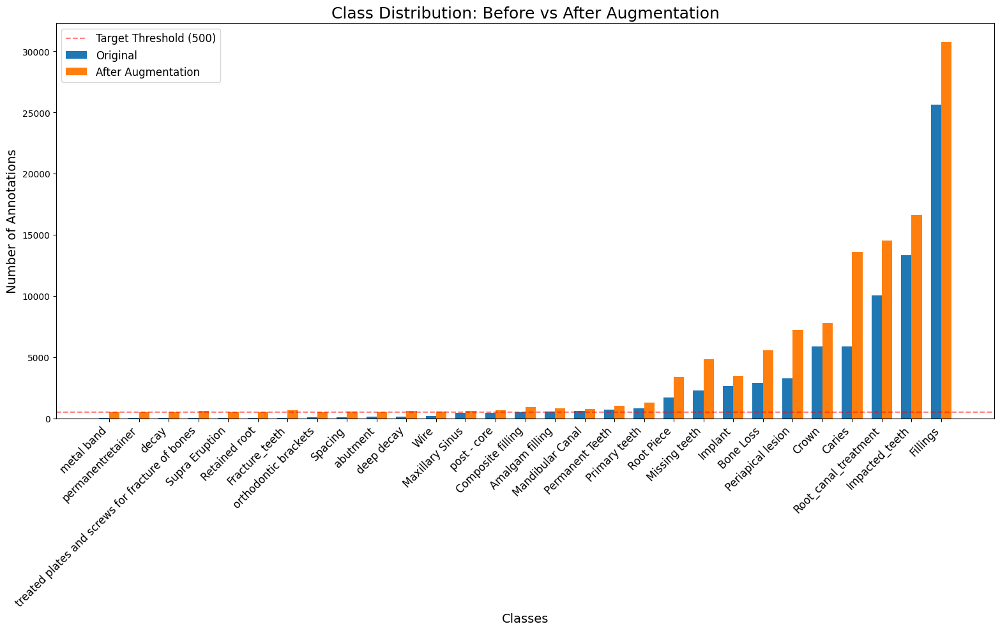


📊 Augmentation Statistics by Class:
                                          Class  Original Count  Augmented Count  Added  Increase %
                                     metal band              10              500    490      4900.0
                              permanentretainer              10              501    491      4910.0
                                          decay              10              500    490      4900.0
treated plates and screws for fracture of bones              12              588    576      4800.0
                                 Supra Eruption              16              500    484      3025.0
                                  Retained root              22              501    479      2177.3
                                 Fracture_teeth              48              670    622      1295.8
                           orthodontic brackets              86              508    422       490.7
                                        Spacing              86

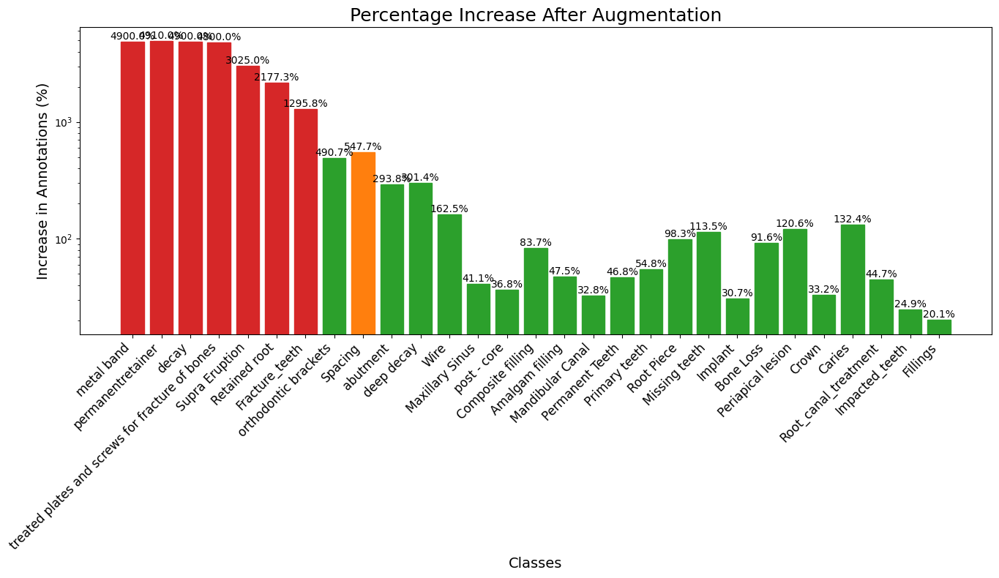


📊 Class Balance Improvement:
Original imbalance ratio: 2560.4:1
Final imbalance ratio: 61.5:1

🌳 Hierarchical Structure:
▶ Bone Loss (5563 annotations)
▶ Caries (13594 annotations)
   └─ decay (500 annotations)
   └─ deep decay (594 annotations)
▶ Fillings (30745 annotations)
   └─ Amalgam filling (826 annotations)
   └─ Composite filling (926 annotations)
▶ Fracture_teeth (670 annotations)
▶ Impacted_teeth (16608 annotations)
▶ Implant (3447 annotations)
▶ Mandibular Canal (778 annotations)
▶ Maxillary Sinus (604 annotations)
▶ Missing teeth (4833 annotations)
▶ Orthodontic_appliance (0 annotations)
   └─ metal band (500 annotations)
   └─ orthodontic brackets (508 annotations)
   └─ permanentretainer (501 annotations)
▶ Periapical lesion (7199 annotations)
▶ Permanent Teeth (1022 annotations)
▶ Primary teeth (1269 annotations)
▶ Prosthodontics (0 annotations)
   └─ Crown (7790 annotations)
   └─ abutment (504 annotations)
   └─ bridge (0 annotations)
   └─ post - core (632 annotatio

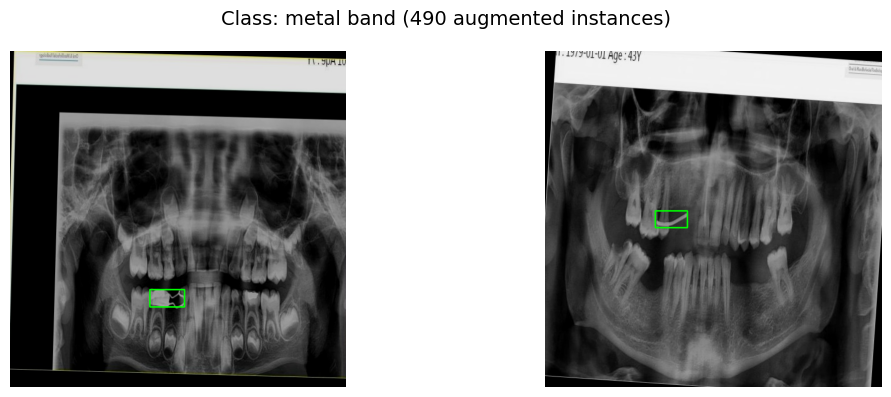

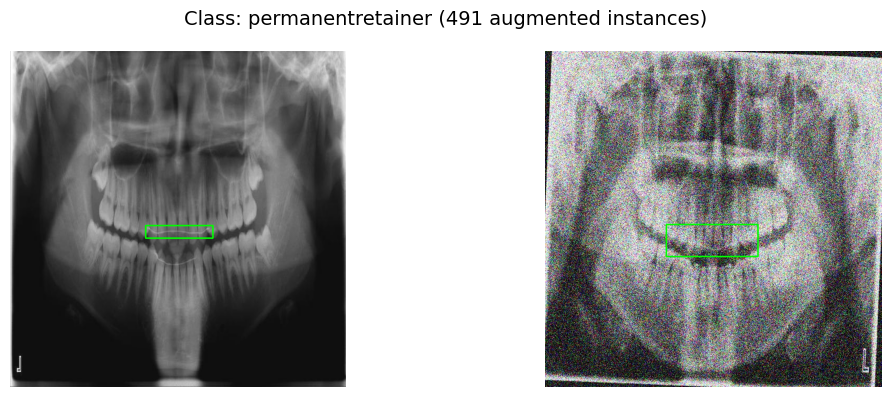

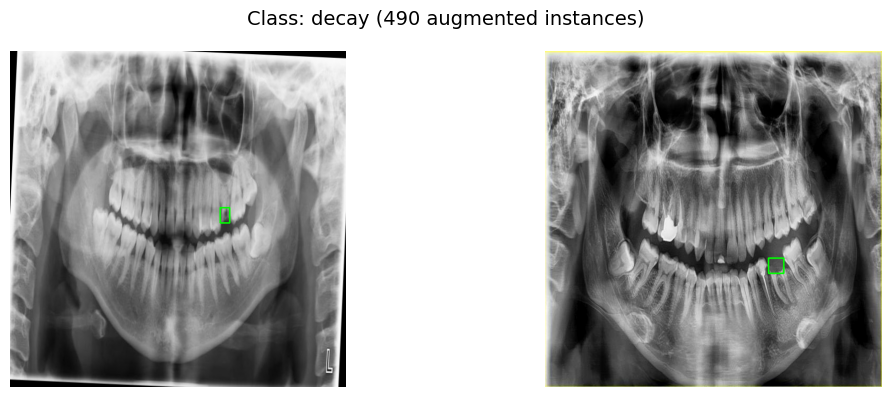

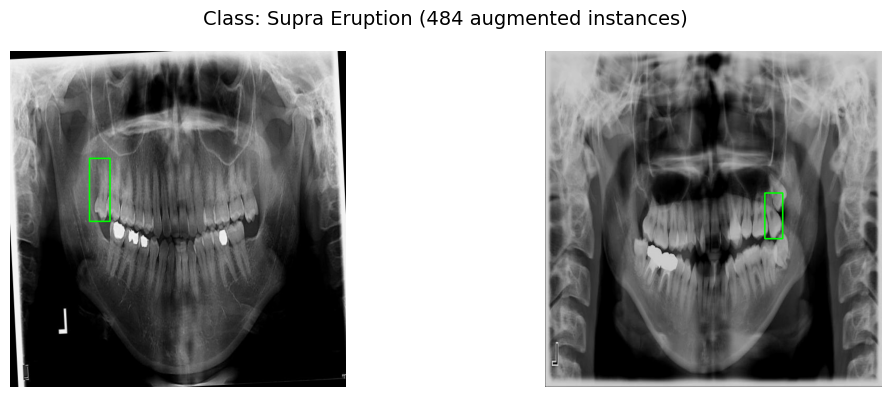

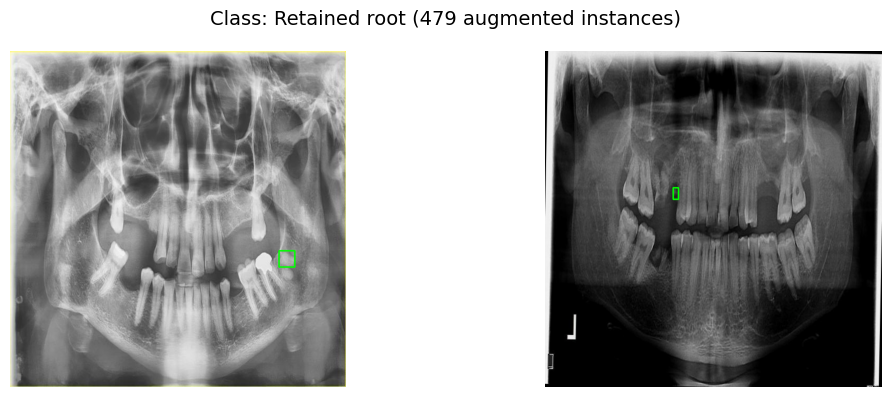


📊 Common Classes (lightly augmented):


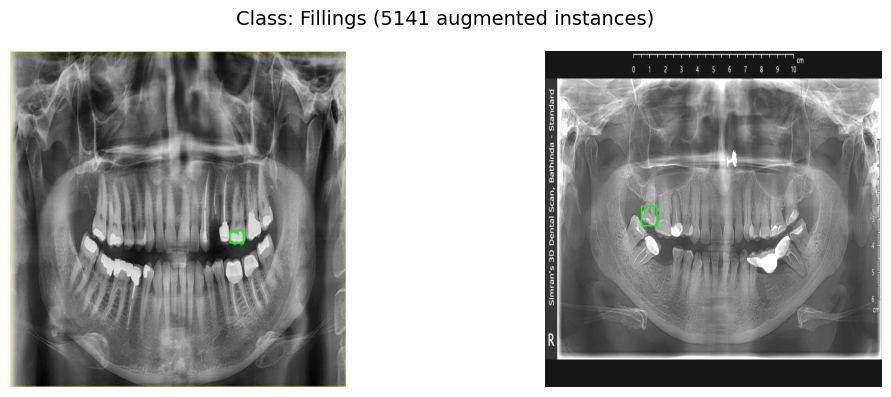

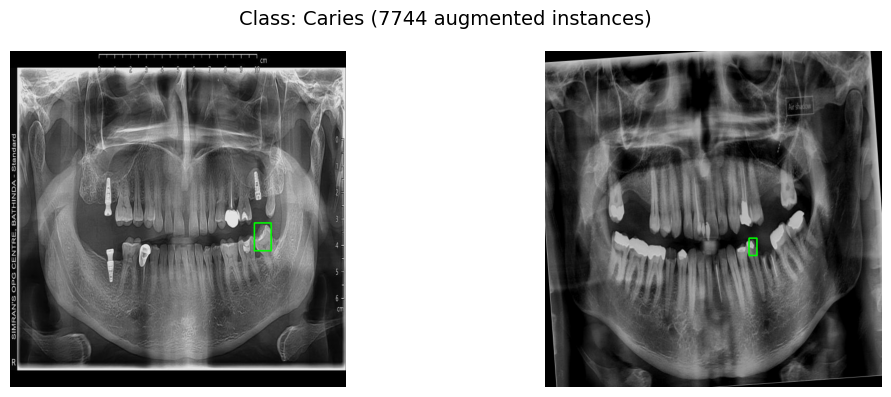

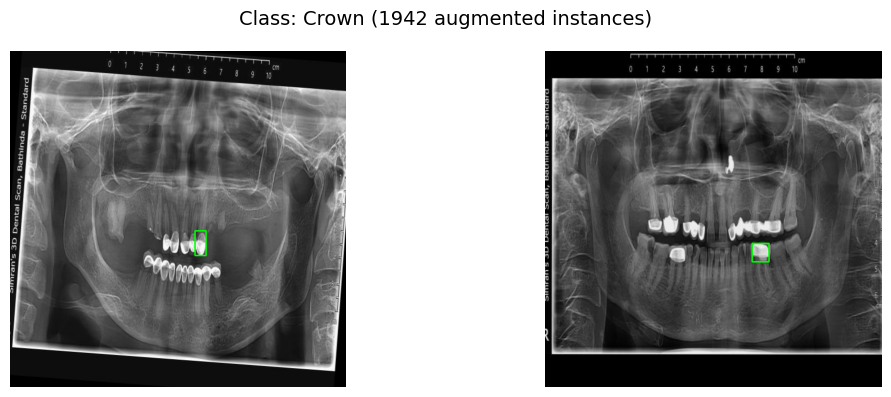

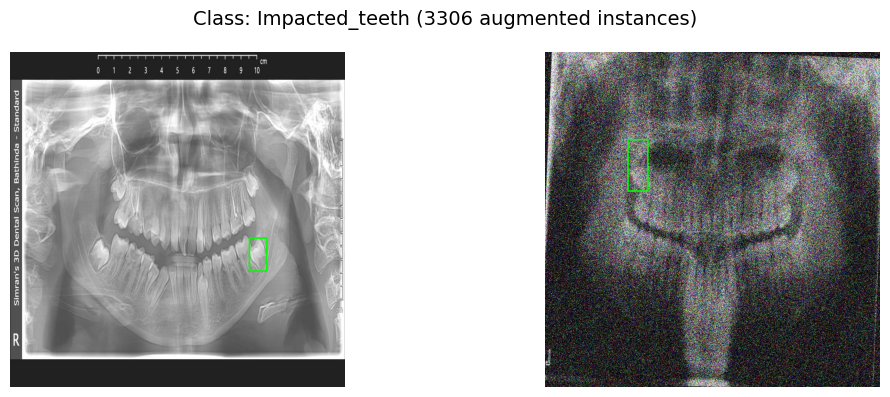


🎯 Performing quality analysis...

🔍 Analyzing augmentation quality...


The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.


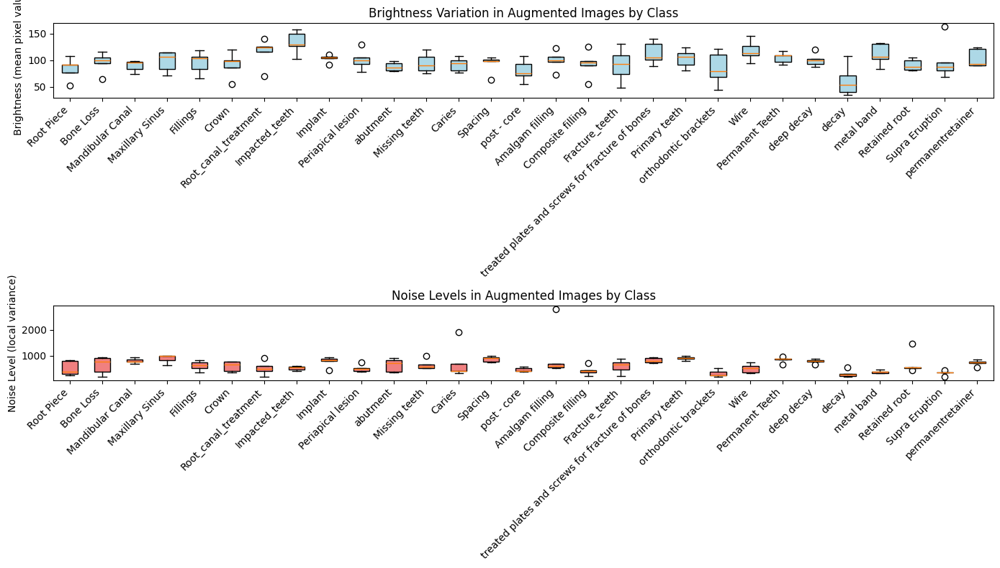


📊 Augmentation Quality Summary:
Amalgam filling           - Avg Brightness: 99.9, Avg Noise: 1036.3
Bone Loss                 - Avg Brightness: 95.9, Avg Noise: 642.7
Caries                    - Avg Brightness: 91.8, Avg Noise: 745.0
Composite filling         - Avg Brightness: 92.9, Avg Noise: 423.0
Crown                     - Avg Brightness: 91.7, Avg Noise: 592.6
Fillings                  - Avg Brightness: 96.2, Avg Noise: 616.3
Fracture_teeth            - Avg Brightness: 91.0, Avg Noise: 593.3
Impacted_teeth            - Avg Brightness: 133.6, Avg Noise: 520.0
Implant                   - Avg Brightness: 103.6, Avg Noise: 779.4
Mandibular Canal          - Avg Brightness: 89.6, Avg Noise: 797.3
Maxillary Sinus           - Avg Brightness: 98.2, Avg Noise: 884.7
Missing teeth             - Avg Brightness: 94.6, Avg Noise: 651.5
Periapical lesion         - Avg Brightness: 101.2, Avg Noise: 512.7
Permanent Teeth           - Avg Brightness: 105.1, Avg Noise: 851.2
Primary teeth           

In [ ]:
import os
import json
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from collections import defaultdict
import cv2
import random
import pandas as pd

def analyze_augmentation_results(dataset_path="/content/vzrad2-4"):
    """
    Analyze and visualize the augmentation results, comparing before and after states
    """
    # Load original annotations
    original_ann = os.path.join(dataset_path, "train", "_annotations_balanced.json")
    augmented_ann = os.path.join(dataset_path, "train", "_annotations_augmented.json")

    if not os.path.exists(original_ann) or not os.path.exists(augmented_ann):
        print("❌ Required annotation files not found.")
        return

    with open(original_ann, 'r') as f:
        original_data = json.load(f)

    with open(augmented_ann, 'r') as f:
        augmented_data = json.load(f)

    # Count annotations per class
    orig_class_counts = defaultdict(int)
    aug_class_counts = defaultdict(int)

    # Create mappings
    orig_cat_id_to_name = {cat['id']: cat['name'] for cat in original_data['categories']}
    aug_cat_id_to_name = {cat['id']: cat['name'] for cat in augmented_data['categories']}

    for ann in original_data['annotations']:
        orig_class_counts[orig_cat_id_to_name[ann['category_id']]] += 1

    for ann in augmented_data['annotations']:
        aug_class_counts[aug_cat_id_to_name[ann['category_id']]] += 1

    # Convert to DataFrames for easier manipulation
    orig_df = pd.DataFrame(list(orig_class_counts.items()), columns=['Class', 'Original Count'])
    aug_df = pd.DataFrame(list(aug_class_counts.items()), columns=['Class', 'Augmented Count'])

    # Merge dataframes
    comparison_df = pd.merge(orig_df, aug_df, on='Class', how='outer').fillna(0)
    comparison_df['Added'] = comparison_df['Augmented Count'] - comparison_df['Original Count']
    comparison_df['Increase %'] = ((comparison_df['Augmented Count'] - comparison_df['Original Count']) /
                                   comparison_df['Original Count'].replace(0, 1) * 100).round(1)

    # Sort by original count to group rare classes together
    comparison_df = comparison_df.sort_values('Original Count')

    # 1. Bar chart: Before and After comparison
    plt.figure(figsize=(16, 10))
    x = np.arange(len(comparison_df))
    width = 0.35

    plt.bar(x - width/2, comparison_df['Original Count'], width, label='Original', color='#1f77b4')
    plt.bar(x + width/2, comparison_df['Augmented Count'], width, label='After Augmentation', color='#ff7f0e')

    plt.xlabel('Classes', fontsize=14)
    plt.ylabel('Number of Annotations', fontsize=14)
    plt.title('Class Distribution: Before vs After Augmentation', fontsize=18)
    plt.xticks(x, comparison_df['Class'], rotation=45, ha='right', fontsize=12)
    plt.axhline(y=500, color='red', linestyle='--', alpha=0.5, label='Target Threshold (500)')
    plt.legend(fontsize=12)
    plt.tight_layout()
    plt.show()

    # 2. Display statistics table
    print("\n📊 Augmentation Statistics by Class:")
    print(comparison_df.to_string(index=False))

    # 3. Percentage increase visualization for classes that were augmented
    augmented_classes = comparison_df[comparison_df['Added'] > 0]

    if not augmented_classes.empty:
        plt.figure(figsize=(14, 8))
        bars = plt.bar(augmented_classes['Class'], augmented_classes['Increase %'])

        # Color the bars based on how much augmentation was needed
        for i, bar in enumerate(bars):
            percent = augmented_classes['Increase %'].iloc[i]
            if percent > 1000:  # Very rare classes
                bar.set_color('#d62728')  # Red
            elif percent > 500:  # Rare classes
                bar.set_color('#ff7f0e')  # Orange
            else:  # Moderate augmentation
                bar.set_color('#2ca02c')  # Green

        plt.xlabel('Classes', fontsize=14)
        plt.ylabel('Increase in Annotations (%)', fontsize=14)
        plt.title('Percentage Increase After Augmentation', fontsize=18)
        plt.xticks(rotation=45, ha='right', fontsize=12)
        plt.yscale('log')  # Use log scale for better visualization of large increases

        # Add percentage labels on bars
        for i, v in enumerate(augmented_classes['Increase %']):
            plt.text(i, v, f'{v}%', ha='center', va='bottom', fontsize=10)

        plt.tight_layout()
        plt.show()

    # 4. Class balance analysis
    original_imbalance = orig_class_counts[max(orig_class_counts, key=orig_class_counts.get)] / \
                        orig_class_counts[min(orig_class_counts, key=orig_class_counts.get)]

    augmented_imbalance = aug_class_counts[max(aug_class_counts, key=aug_class_counts.get)] / \
                         aug_class_counts[min(aug_class_counts, key=aug_class_counts.get)]

    print(f"\n📊 Class Balance Improvement:")
    print(f"Original imbalance ratio: {original_imbalance:.1f}:1")
    print(f"Final imbalance ratio: {augmented_imbalance:.1f}:1")

    # 5. Hierarchical structure visualization
    parent_classes = set()
    sub_classes = defaultdict(list)

    for cat in augmented_data['categories']:
        if cat.get('is_parent', False):
            parent_classes.add(cat['name'])
        elif cat.get('is_subclass', False):
            parent_name = cat.get('supercategory', 'Unknown')
            sub_classes[parent_name].append(cat['name'])

    if parent_classes:
        print("\n🌳 Hierarchical Structure:")
        for parent in sorted(parent_classes):
            parent_count = aug_class_counts.get(parent, 0)
            print(f"▶ {parent} ({parent_count} annotations)")
            for sub in sorted(sub_classes.get(parent, [])):
                sub_count = aug_class_counts.get(sub, 0)
                print(f"   └─ {sub} ({sub_count} annotations)")

    # 6. Visualize sample augmentations
    print("\n🖼️ Sample Augmented Images by Class:")

    # Create mappings for augmented data
    aug_img_map = {img['id']: img for img in augmented_data['images']}
    aug_cat_map = {cat['id']: cat for cat in augmented_data['categories']}

    # Group augmented annotations by class
    class_anns_aug = defaultdict(list)
    for ann in augmented_data['annotations']:
        class_id = ann['category_id']
        img_info = aug_img_map.get(ann['image_id'])
        if img_info and img_info['file_name'].startswith('aug_'):
            class_anns_aug[class_id].append(ann)

    # Show samples from key classes (rare vs common)
    rare_classes = ['metal band', 'permanentretainer', 'decay', 'Supra Eruption', 'Plating', 'Retained root']
    common_classes = ['Fillings', 'Caries', 'Crown', 'Impacted_teeth']

    # Plot samples from rare classes
    print("\n🔍 Rare Classes (heavily augmented):")
    show_class_samples(rare_classes, class_anns_aug, aug_cat_map, aug_img_map, dataset_path, 2)

    # Plot samples from common classes
    print("\n📊 Common Classes (lightly augmented):")
    show_class_samples(common_classes, class_anns_aug, aug_cat_map, aug_img_map, dataset_path, 2)

    return comparison_df


def show_class_samples(classes, class_anns_aug, aug_cat_map, aug_img_map, dataset_path, num_samples=2):
    """Helper function to display sample images for specific classes"""
    for class_name in classes:
        # Find the class ID
        class_id = None
        for cat_id, cat in aug_cat_map.items():
            if cat['name'] == class_name:
                class_id = cat_id
                break

        if class_id is None or class_id not in class_anns_aug:
            continue

        anns = class_anns_aug[class_id]
        if not anns:
            continue

        # Select random samples
        samples = random.sample(anns, min(num_samples, len(anns)))

        fig, axes = plt.subplots(1, len(samples), figsize=(12, 4))
        if len(samples) == 1:
            axes = [axes]

        fig.suptitle(f"Class: {class_name} ({len(anns)} augmented instances)", fontsize=14)

        for i, ann in enumerate(samples):
            img_info = aug_img_map[ann['image_id']]
            img_path = os.path.join(dataset_path, "train", img_info['file_name'])

            try:
                image = cv2.imread(img_path)
                if image is None:
                    continue

                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Draw bounding box
                bbox = ann['bbox']
                x, y, w, h = [int(v) for v in bbox]
                cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)

                # Display
                axes[i].imshow(image)
                axes[i].axis('off')

            except Exception as e:
                print(f"Error displaying image: {str(e)}")

        plt.tight_layout()
        plt.show()


def visualize_augmentation_quality(dataset_path="/content/vzrad2-4"):
    """
    Analyze the quality of augmentations applied to different classes
    """
    # Load augmented annotations
    augmented_ann = os.path.join(dataset_path, "train", "_annotations_augmented.json")

    with open(augmented_ann, 'r') as f:
        augmented_data = json.load(f)

    # Create mappings
    aug_img_map = {img['id']: img for img in augmented_data['images']}
    aug_cat_map = {cat['id']: cat for cat in augmented_data['categories']}

    # Group augmented images by class
    class_anns_aug = defaultdict(list)
    for ann in augmented_data['annotations']:
        class_id = ann['category_id']
        img_info = aug_img_map.get(ann['image_id'])
        # Only include augmented images
        if img_info and img_info['file_name'].startswith('aug_'):
            class_anns_aug[class_id].append((ann, img_info))

    # Analyze brightness and contrast variations for augmented images
    brightness_variations = defaultdict(list)
    noise_levels = defaultdict(list)

    print("\n🔍 Analyzing augmentation quality...")

    # Sample 5 images per class for analysis
    for class_id, anns_info in class_anns_aug.items():
        class_name = aug_cat_map[class_id]['name']

        if not anns_info:
            continue

        samples = random.sample(anns_info, min(5, len(anns_info)))

        for ann, img_info in samples:
            img_path = os.path.join(dataset_path, "train", img_info['file_name'])
            try:
                image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
                if image is None:
                    continue

                # Measure brightness
                brightness = np.mean(image)
                brightness_variations[class_name].append(brightness)

                # Measure noise (local variance)
                # Divide image into patches and compute variance
                h, w = image.shape
                patch_size = 16
                local_vars = []

                for i in range(0, h - patch_size, patch_size):
                    for j in range(0, w - patch_size, patch_size):
                        patch = image[i:i+patch_size, j:j+patch_size]
                        local_vars.append(np.var(patch))

                noise_level = np.mean(local_vars)
                noise_levels[class_name].append(noise_level)

            except Exception as e:
                print(f"Error analyzing image: {str(e)}")

    # Visualize augmentation quality metrics
    plt.figure(figsize=(14, 8))

    # Brightness variation
    plt.subplot(2, 1, 1)
    classes = list(brightness_variations.keys())
    brightness_data = [brightness_variations[c] for c in classes]

    bp1 = plt.boxplot(brightness_data, labels=classes, patch_artist=True)
    for box in bp1['boxes']:
        box.set(facecolor='lightblue')

    plt.xticks(rotation=45, ha='right')
    plt.ylabel('Brightness (mean pixel value)')
    plt.title('Brightness Variation in Augmented Images by Class')

    # Noise levels
    plt.subplot(2, 1, 2)
    noise_data = [noise_levels[c] for c in classes]

    bp2 = plt.boxplot(noise_data, labels=classes, patch_artist=True)
    for box in bp2['boxes']:
        box.set(facecolor='lightcoral')

    plt.xticks(rotation=45, ha='right')
    plt.ylabel('Noise Level (local variance)')
    plt.title('Noise Levels in Augmented Images by Class')

    plt.tight_layout()
    plt.show()

    # Summary statistics
    print("\n📊 Augmentation Quality Summary:")
    for class_name in sorted(brightness_variations.keys()):
        if brightness_variations[class_name] and noise_levels[class_name]:
            avg_brightness = np.mean(brightness_variations[class_name])
            avg_noise = np.mean(noise_levels[class_name])
            print(f"{class_name:<25} - Avg Brightness: {avg_brightness:.1f}, Avg Noise: {avg_noise:.1f}")


# Run the analysis
if __name__ == "__main__":
    print("🔄 Analyzing augmentation results...")
    comparison_df = analyze_augmentation_results()

    print("\n🎯 Performing quality analysis...")
    visualize_augmentation_quality()

    # Export results to CSV for further analysis
    if comparison_df is not None:
        comparison_df.to_csv('/content/augmentation_analysis.csv', index=False)
        print("\n💾 Analysis results saved to augmentation_analysis.csv")

    print("\n✅ Analysis complete!")

<hr>

# 🧠 **EfficientNetV2 Training and Evaluation** :

This section implements the dental X-ray object detection model using EfficientNetV2. The well-documented code includes dataset preparation, model definition with Focal Loss for handling class imbalance, training pipeline with learning rate scheduling, and comprehensive evaluation metrics. **Detailed comments throughout explain key techniques and implementation decisions**.

Using device: cuda
🔄 Preparing datasets...
Class distribution in dataset:
  Fillings: 30745 samples (25.6%)
  Crown: 7790 samples (6.5%)
  Root_canal_treatment: 14514 samples (12.1%)
  Mandibular Canal: 778 samples (0.6%)
  Maxillary Sinus: 604 samples (0.5%)
  Bone Loss: 5563 samples (4.6%)
  Impacted_teeth: 16608 samples (13.8%)
  Periapical lesion: 7199 samples (6.0%)
  Root Piece: 3387 samples (2.8%)
  Caries: 13594 samples (11.3%)
  Missing teeth: 4833 samples (4.0%)
  Implant: 3447 samples (2.9%)
  Composite filling: 926 samples (0.8%)
  Amalgam filling: 826 samples (0.7%)
  abutment: 504 samples (0.4%)
  post - core: 632 samples (0.5%)
  Primary teeth: 1269 samples (1.1%)
  Fracture_teeth: 670 samples (0.6%)
  orthodontic brackets: 508 samples (0.4%)
  deep decay: 594 samples (0.5%)
  Wire: 525 samples (0.4%)
  Permanent Teeth: 1022 samples (0.9%)
  Spacing: 557 samples (0.5%)
  decay: 500 samples (0.4%)
  treated plates and screws for fracture of bones: 588 samples (0.5%)
  met

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_S_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_S_Weights.DEFAULT` to get the most up-to-date weights.
Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth
100%|██████████| 82.7M/82.7M [00:00<00:00, 216MB/s]
The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.


🔄 Using Focal Loss with gamma=2.0
🔄 Starting training...

Epoch 1/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.64it/s]


✅ New best model saved! (Epoch 1)
Train Loss: 0.2977 - Train Acc: 0.8517
Val Loss: 0.1176 - Val Acc: 0.9254
Learning Rate: 0.00010000

Epoch 2/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:43<00:00, 34.40it/s]


✅ New best model saved! (Epoch 2)
Train Loss: 0.1182 - Train Acc: 0.9212
Val Loss: 0.0935 - Val Acc: 0.9318
Learning Rate: 0.00010000

Epoch 3/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.83it/s]


✅ New best model saved! (Epoch 3)
Train Loss: 0.0848 - Train Acc: 0.9383
Val Loss: 0.0834 - Val Acc: 0.9437
Learning Rate: 0.00010000

Epoch 4/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:43<00:00, 34.17it/s]


✅ New best model saved! (Epoch 4)
Train Loss: 0.0659 - Train Acc: 0.9482
Val Loss: 0.0676 - Val Acc: 0.9478
Learning Rate: 0.00010000

Epoch 5/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.79it/s]


✅ New best model saved! (Epoch 5)
Train Loss: 0.0537 - Train Acc: 0.9550
Val Loss: 0.0568 - Val Acc: 0.9581
Learning Rate: 0.00010000

🔄 Generating confusion matrices...

Train Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.91      0.86      0.89       403
                                          Crown       0.91      0.95      0.93      6232
                                    post - core       0.91      0.86      0.88       506
                                     metal band       0.98      0.97      0.98       400
                              permanentretainer       0.97      0.97      0.97       401
                           orthodontic brackets       0.98      0.99      0.98       406
                                         Caries       0.95      0.95      0.95     10875
                                          decay       0.95      0.95      0.95       40

Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.82it/s]


Train Loss: 0.0478 - Train Acc: 0.9586
Val Loss: 0.0599 - Val Acc: 0.9538
Learning Rate: 0.00010000

Epoch 7/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.51it/s]


✅ New best model saved! (Epoch 7)
Train Loss: 0.0400 - Train Acc: 0.9635
Val Loss: 0.0475 - Val Acc: 0.9652
Learning Rate: 0.00010000

Epoch 8/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.78it/s]


✅ New best model saved! (Epoch 8)
Train Loss: 0.0361 - Train Acc: 0.9660
Val Loss: 0.0465 - Val Acc: 0.9652
Learning Rate: 0.00010000

Epoch 9/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.82it/s]


Train Loss: 0.0336 - Train Acc: 0.9688
Val Loss: 0.0532 - Val Acc: 0.9639
Learning Rate: 0.00010000

Epoch 10/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:43<00:00, 34.24it/s]


✅ New best model saved! (Epoch 10)
Train Loss: 0.0326 - Train Acc: 0.9700
Val Loss: 0.0449 - Val Acc: 0.9690
Learning Rate: 0.00010000

🔄 Generating confusion matrices...

Train Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.91      0.90      0.91       403
                                          Crown       0.93      0.96      0.94      6232
                                    post - core       0.93      0.92      0.92       506
                                     metal band       0.99      0.99      0.99       400
                              permanentretainer       0.99      0.99      0.99       401
                           orthodontic brackets       0.99      0.99      0.99       406
                                         Caries       0.97      0.97      0.97     10875
                                          decay       0.98      0.97      0.97       4

Validating: 100%|██████████| 1503/1503 [00:44<00:00, 34.02it/s]


✅ New best model saved! (Epoch 11)
Train Loss: 0.0287 - Train Acc: 0.9731
Val Loss: 0.0416 - Val Acc: 0.9703
Learning Rate: 0.00010000

Epoch 12/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.86it/s]


✅ New best model saved! (Epoch 12)
Train Loss: 0.0274 - Train Acc: 0.9736
Val Loss: 0.0417 - Val Acc: 0.9704
Learning Rate: 0.00010000

Epoch 13/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.70it/s]


Train Loss: 0.0263 - Train Acc: 0.9749
Val Loss: 0.0637 - Val Acc: 0.9699
Learning Rate: 0.00010000

Epoch 14/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.69it/s]


Train Loss: 0.0245 - Train Acc: 0.9766
Val Loss: 0.0550 - Val Acc: 0.9673
Learning Rate: 0.00010000

Epoch 15/15
--------------------


Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.76it/s]


Train Loss: 0.0229 - Train Acc: 0.9780
Val Loss: 0.0515 - Val Acc: 0.9700
Learning Rate: 0.00010000

🔄 Generating confusion matrices...

Train Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.97      0.94      0.96       403
                                          Crown       0.94      0.97      0.95      6232
                                    post - core       0.96      0.95      0.95       506
                                     metal band       0.99      0.98      0.98       400
                              permanentretainer       0.98      0.99      0.98       401
                           orthodontic brackets       0.99      0.99      0.99       406
                                         Caries       0.97      0.98      0.97     10875
                                          decay       0.99      0.98      0.99       400
                                

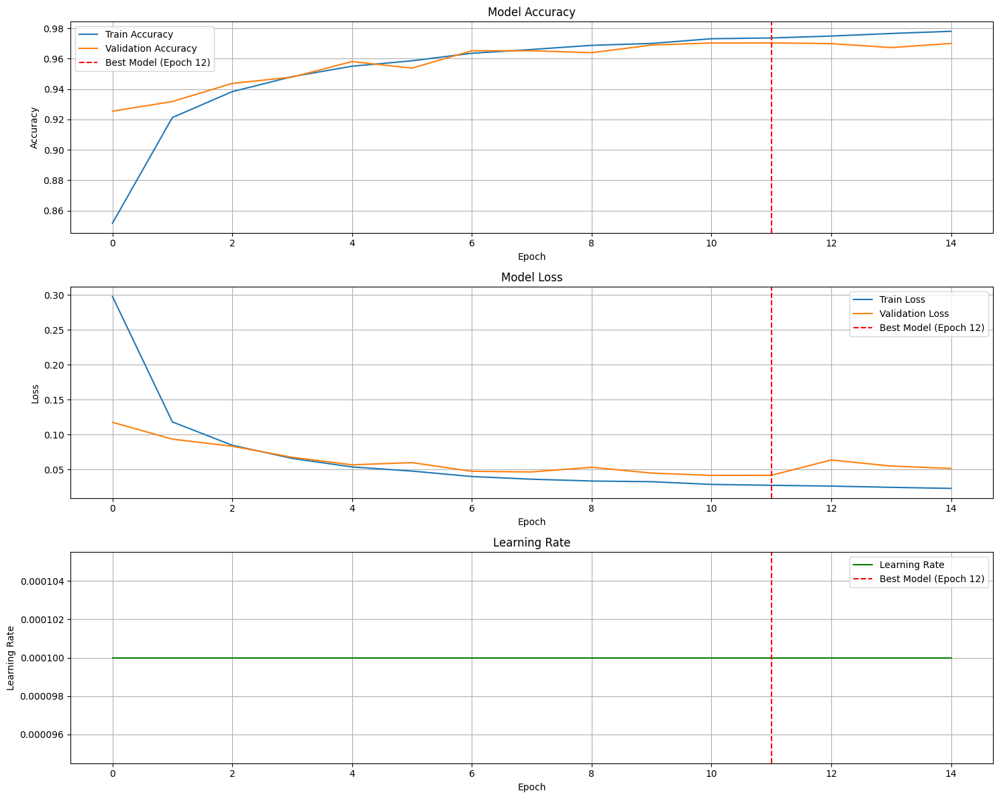


📊 Training History:
Epoch | Train Loss |  Train Acc |   Val Loss |    Val Acc |         LR
-----------------------------------------------------------------
    1 |     0.2977 |     0.8517 |     0.1176 |     0.9254 | 0.00010000
    2 |     0.1182 |     0.9212 |     0.0935 |     0.9318 | 0.00010000
    3 |     0.0848 |     0.9383 |     0.0834 |     0.9437 | 0.00010000
    4 |     0.0659 |     0.9482 |     0.0676 |     0.9478 | 0.00010000
    5 |     0.0537 |     0.9550 |     0.0568 |     0.9581 | 0.00010000
    6 |     0.0478 |     0.9586 |     0.0599 |     0.9538 | 0.00010000
    7 |     0.0400 |     0.9635 |     0.0475 |     0.9652 | 0.00010000
    8 |     0.0361 |     0.9660 |     0.0465 |     0.9652 | 0.00010000
    9 |     0.0336 |     0.9688 |     0.0532 |     0.9639 | 0.00010000
   10 |     0.0326 |     0.9700 |     0.0449 |     0.9690 | 0.00010000
   11 |     0.0287 |     0.9731 |     0.0416 |     0.9703 | 0.00010000
   12 |     0.0274 |     0.9736 |     0.0417 |     0.9704 | 0

Validating: 100%|██████████| 1503/1503 [00:44<00:00, 33.87it/s]


Best model validation accuracy: 0.9704

Best_model Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.91      0.95      0.93       101
                                          Crown       0.93      0.96      0.95      1558
                                    post - core       0.97      0.95      0.96       126
                                     metal band       0.99      0.93      0.96       100
                              permanentretainer       0.93      1.00      0.97       100
                           orthodontic brackets       0.99      1.00      1.00       102
                                         Caries       0.98      0.97      0.97      2719
                                          decay       0.99      0.93      0.96       100
                                     deep decay       0.92      0.97      0.94       119
                                   

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import json
import cv2
from collections import defaultdict
import os
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pickle
from tqdm import tqdm
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

class FocalLoss(nn.Module):
    """Focal Loss implementation for handling class imbalance"""
    def __init__(self, alpha=1, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction
        self.ce_loss = nn.CrossEntropyLoss(reduction='none')

    def forward(self, inputs, targets):
        ce_loss = self.ce_loss(inputs, targets)
        pt = torch.exp(-ce_loss)
        focal_loss = self.alpha * (1 - pt) ** self.gamma * ce_loss

        if self.reduction == 'mean':
            return torch.mean(focal_loss)
        elif self.reduction == 'sum':
            return torch.sum(focal_loss)
        else:
            return focal_loss

class DentalDataset(Dataset):
    """PyTorch Dataset for dental X-ray images"""
    def __init__(self, annotations, images_dir, transform=None):
        self.annotations = annotations
        self.images_dir = images_dir
        self.transform = transform

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        ann = self.annotations[idx]

        # Load image
        img_path = os.path.join(self.images_dir, ann['img_file'])
        image = cv2.imread(img_path)

        if image is None:
            # Return a dummy image if loading fails
            image = np.zeros((224, 224, 3), dtype=np.uint8)
        else:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Crop with bounding box
            x, y, w, h = map(int, ann['bbox'])
            cropped = image[y:y+h, x:x+w]

            if cropped.size == 0:
                image = np.zeros((224, 224, 3), dtype=np.uint8)
            else:
                image = cv2.resize(cropped, (224, 224))

        # Apply transforms
        if self.transform:
            image = self.transform(image)

        # Convert label to tensor
        label = ann['label_idx']

        return image, label

class EfficientNetV2Model(nn.Module):
    """EfficientNet V2 model for dental classification"""
    def __init__(self, num_classes):
        super(EfficientNetV2Model, self).__init__()

        # Load pretrained EfficientNet V2 Small
        self.efficientnet = models.efficientnet_v2_s(pretrained=True)

        # Freeze early layers
        for param in list(self.efficientnet.features.parameters())[:30]:
            param.requires_grad = False

        # Modify classifier
        num_ftrs = self.efficientnet.classifier[1].in_features
        self.efficientnet.classifier = nn.Sequential(
            nn.Dropout(0.2),
            nn.Linear(num_ftrs, num_classes)
        )

    def forward(self, x):
        return self.efficientnet(x)

def load_annotations(annotation_path):
    """Load annotations from JSON file"""
    with open(annotation_path, 'r') as f:
        data = json.load(f)

    # Create mappings
    cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
    img_id_to_file = {img['id']: img['file_name'] for img in data['images']}

    # Process annotations
    annotations = []
    for ann in data['annotations']:
        annotations.append({
            'img_file': img_id_to_file[ann['image_id']],
            'bbox': ann['bbox'],
            'category_id': ann['category_id']
        })

    return annotations, data['categories'], cat_id_to_name

def prepare_datasets(dataset_path, batch_size=16):
    """Prepare training and validation datasets"""

    # Load annotations
    annotation_path = os.path.join(dataset_path, 'train', '_annotations_augmented.json')
    images_dir = os.path.join(dataset_path, 'train')

    annotations, categories, cat_id_to_name = load_annotations(annotation_path)

    # Map category IDs to indices
    unique_cat_ids = sorted(set(ann['category_id'] for ann in annotations))
    cat_id_to_idx = {cat_id: idx for idx, cat_id in enumerate(unique_cat_ids)}
    num_classes = len(unique_cat_ids)

    # Count samples per class for class weights
    class_counts = defaultdict(int)
    for ann in annotations:
        cat_id = ann['category_id']
        class_counts[cat_id] += 1

    # Calculate class weights for balanced training
    total_samples = len(annotations)
    class_weights = {cat_id: total_samples / (len(class_counts) * count)
                    for cat_id, count in class_counts.items()}

    # Print class distribution
    print("Class distribution in dataset:")
    for cat_id, count in class_counts.items():
        name = cat_id_to_name.get(cat_id, f"Unknown ({cat_id})")
        print(f"  {name}: {count} samples ({count/total_samples*100:.1f}%)")

    # Update annotations with label indices
    for ann in annotations:
        ann['label_idx'] = cat_id_to_idx[ann['category_id']]

    # Split data
    train_anns, val_anns = train_test_split(annotations, test_size=0.2, random_state=42,
                                           stratify=[ann['category_id'] for ann in annotations])

    # Define transforms with data augmentation for training
    train_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(10),
        transforms.ColorJitter(brightness=0.2, contrast=0.2),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    val_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Create datasets
    train_dataset = DentalDataset(train_anns, images_dir, transform=train_transform)
    val_dataset = DentalDataset(val_anns, images_dir, transform=val_transform)

    # Create dataloaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    return train_loader, val_loader, num_classes, cat_id_to_idx, cat_id_to_name, class_weights

def train_epoch(model, dataloader, criterion, optimizer, device):
    """Train for one epoch"""
    model.train()
    running_loss = 0.0
    running_corrects = 0
    total_samples = 0

    all_preds = []
    all_labels = []

    for batch_idx, (inputs, labels) in enumerate(tqdm(dataloader, desc="Training")):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        with torch.set_grad_enabled(True):
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

            loss.backward()
            optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
        total_samples += inputs.size(0)

        # Store predictions and labels for confusion matrix
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

    epoch_loss = running_loss / total_samples
    epoch_acc = running_corrects.double() / total_samples

    return epoch_loss, epoch_acc, all_preds, all_labels

def validate_epoch(model, dataloader, criterion, device):
    """Validate for one epoch"""
    model.eval()
    running_loss = 0.0
    running_corrects = 0
    total_samples = 0

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc="Validating"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

            # Store predictions and labels for confusion matrix
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    epoch_loss = running_loss / total_samples
    epoch_acc = running_corrects.double() / total_samples

    return epoch_loss, epoch_acc, all_preds, all_labels

def plot_confusion_matrix(y_true, y_pred, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, phase="validation"):
    """Plot confusion matrix for each class"""

    # Calculate confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Get class names
    class_names = [cat_id_to_name[idx_to_cat_id[i]] for i in range(len(cat_id_to_idx))]

    # Plot overall confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {phase.capitalize()}')
    plt.tight_layout()
    plt.savefig(f'{phase}_confusion_matrix.png')
    plt.close()

    # Calculate and plot per-class metrics
    classification_rep = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)

    # Plot individual class performance
    metrics = ['precision', 'recall', 'f1-score']

    plt.figure(figsize=(15, 5))

    # Create a bar chart for each metric
    for i, metric in enumerate(metrics):
        plt.subplot(1, 3, i+1)
        values = [classification_rep[class_name][metric] for class_name in class_names]
        sns.barplot(x=class_names, y=values)
        plt.title(f'{metric.capitalize()} by Class - {phase.capitalize()}')
        plt.xticks(rotation=45, ha='right')
        plt.ylim(0, 1)

    plt.tight_layout()
    plt.savefig(f'{phase}_class_metrics.png')
    plt.close()

    # Calculate per-class error rate
    error_rates = {}
    for i, class_name in enumerate(class_names):
        # Get indices of this class
        class_indices = [j for j, l in enumerate(y_true) if l == i]
        if class_indices:
            # Calculate error rate for this class
            class_errors = sum(1 for j in class_indices if y_pred[j] != y_true[j])
            error_rate = class_errors / len(class_indices)
            error_rates[class_name] = error_rate

    # Plot error rates
    plt.figure(figsize=(10, 6))
    names = list(error_rates.keys())
    values = list(error_rates.values())

    sns.barplot(x=names, y=values)
    plt.title(f'Classification Error Rate by Class - {phase.capitalize()}')
    plt.xticks(rotation=45, ha='right')
    plt.ylabel('Error Rate')
    plt.tight_layout()
    plt.savefig(f'{phase}_error_rates.png')
    plt.close()

    # Print classification report
    print(f"\n{phase.capitalize()} Classification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names))

    return classification_rep

def train_model(dataset_path='/content/vzrad2-4', epochs=15, batch_size=16, learning_rate=0.0001,
               focal_loss_gamma=2.0):
    """Main training function with Focal Loss"""

    # Prepare datasets
    print("🔄 Preparing datasets...")
    train_loader, val_loader, num_classes, cat_id_to_idx, cat_id_to_name, class_weights = prepare_datasets(dataset_path, batch_size)
    idx_to_cat_id = {v: k for k, v in cat_id_to_idx.items()}

    # Create model
    print(f"🔄 Creating EfficientNet V2 model with {num_classes} classes...")
    model = EfficientNetV2Model(num_classes).to(device)

    # Define loss function - Focal Loss
    print(f"🔄 Using Focal Loss with gamma={focal_loss_gamma}")
    criterion = FocalLoss(gamma=focal_loss_gamma)

    # Define optimizer with weight decay to prevent overfitting
    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)

    # Learning rate scheduler - reduce on plateau
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3, verbose=True)

    # Training history
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': [],
        'learning_rate': []
    }

    best_val_acc = 0.0
    best_model_state = None
    best_epoch = 0

    # Training loop
    print("🔄 Starting training...")
    for epoch in range(epochs):
        print(f"\nEpoch {epoch+1}/{epochs}")
        print("-" * 20)

        # Train
        train_loss, train_acc, train_preds, train_labels = train_epoch(model, train_loader, criterion, optimizer, device)

        # Validate
        val_loss, val_acc, val_preds, val_labels = validate_epoch(model, val_loader, criterion, device)

        # Get current learning rate
        current_lr = optimizer.param_groups[0]['lr']

        # Update learning rate
        scheduler.step(val_acc)

        # Save history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc.item())
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc.item())
        history['learning_rate'].append(current_lr)

        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = model.state_dict()
            best_epoch = epoch
            torch.save(best_model_state, 'best_model.pth')
            print(f"✅ New best model saved! (Epoch {epoch+1})")

        # Print epoch summary
        print(f"Train Loss: {train_loss:.4f} - Train Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f} - Val Acc: {val_acc:.4f}")
        print(f"Learning Rate: {current_lr:.8f}")

        # Plot confusion matrix every 5 epochs and on last epoch
        if (epoch + 1) % 5 == 0 or epoch == epochs - 1:
            print("\n🔄 Generating confusion matrices...")
            train_metrics = plot_confusion_matrix(train_labels, train_preds, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, "train")
            val_metrics = plot_confusion_matrix(val_labels, val_preds, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, "validation")

    # Plot training metrics over time
    plt.figure(figsize=(15, 12))

    # Accuracy plot
    plt.subplot(3, 1, 1)
    plt.plot(history['train_acc'], label='Train Accuracy')
    plt.plot(history['val_acc'], label='Validation Accuracy')
    plt.axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Model (Epoch {best_epoch+1})')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)

    # Loss plot
    plt.subplot(3, 1, 2)
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Model (Epoch {best_epoch+1})')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    # Learning rate plot
    plt.subplot(3, 1, 3)
    plt.plot(history['learning_rate'], label='Learning Rate', color='g')
    plt.axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Model (Epoch {best_epoch+1})')
    plt.title('Learning Rate')
    plt.xlabel('Epoch')
    plt.ylabel('Learning Rate')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.savefig('training_metrics.png')
    plt.show()

    # Print training history
    print("\n📊 Training History:")
    print(f"{'Epoch':>5} | {'Train Loss':>10} | {'Train Acc':>10} | {'Val Loss':>10} | {'Val Acc':>10} | {'LR':>10}")
    print("-" * 65)
    for epoch in range(epochs):
        print(f"{epoch+1:5d} | {history['train_loss'][epoch]:10.4f} | {history['train_acc'][epoch]:10.4f} | "
              f"{history['val_loss'][epoch]:10.4f} | {history['val_acc'][epoch]:10.4f} | {history['learning_rate'][epoch]:10.8f}")

    # Save final model
    torch.save(model.state_dict(), 'final_model.pth')

    # Save history
    with open('training_history.pkl', 'wb') as f:
        pickle.dump(history, f)

    # Save category mapping
    mapping_data = {
        'cat_id_to_idx': cat_id_to_idx,
        'cat_id_to_name': cat_id_to_name
    }
    with open('category_mapping.pkl', 'wb') as f:
        pickle.dump(mapping_data, f)

    # Print final metrics
    print("\n✅ Training completed!")
    print(f"Best validation accuracy: {best_val_acc:.4f} (Epoch {best_epoch+1})")
    print(f"Final train accuracy: {history['train_acc'][-1]:.4f}")
    print(f"Final validation accuracy: {history['val_acc'][-1]:.4f}")

    # Load the best model for final evaluation
    model.load_state_dict(torch.load('best_model.pth'))
    print(f"\nLoaded best model from epoch {best_epoch+1} for final evaluation")

    # Final evaluation on validation set
    final_val_loss, final_val_acc, final_val_preds, final_val_labels = validate_epoch(model, val_loader, criterion, device)
    print(f"Best model validation accuracy: {final_val_acc:.4f}")

    # Generate final confusion matrix
    final_metrics = plot_confusion_matrix(final_val_labels, final_val_preds, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, "best_model")

    return model, history, mapping_data

# Run the training
if __name__ == "__main__":
    try:
        model, history, mapping = train_model(
            batch_size=16,
            epochs=15,
            learning_rate=0.0001,
            focal_loss_gamma=2.0  # Adjust gamma parameter for focal loss
        )
        print("✅ Training pipeline completed successfully!")

    except Exception as e:
        print(f"❌ Training pipeline failed: {str(e)}")
        import traceback
        traceback.print_exc()

## 📊 **EfficientNetV2 Testing and Visualization** :

This section evaluates the trained model on the test dataset, with thoroughly commented code for generating detailed confusion matrices, error analysis, and visualizations of predictions to assess model performance across different dental features.** Comments clarify the methodology and interpretation of results**.

Using device: cuda
🔄 Preparing test dataset...
Test set not found, using validation split from training data
🔄 Loading model...


The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_S_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_S_Weights.DEFAULT` to get the most up-to-date weights.


🔄 Evaluating on test set...


Testing: 100%|██████████| 1503/1503 [00:58<00:00, 25.81it/s]



📊 Test Results:
Test Loss: 0.0417
Test Accuracy: 0.9704

🔄 Generating overall confusion matrix...

📊 Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.91      0.95      0.93       101
                                          Crown       0.93      0.96      0.95      1558
                                    post - core       0.97      0.95      0.96       126
                                     metal band       0.99      0.93      0.96       100
                              permanentretainer       0.93      1.00      0.97       100
                           orthodontic brackets       0.99      1.00      1.00       102
                                         Caries       0.98      0.97      0.97      2719
                                          decay       0.99      0.93      0.96       100
                                     deep decay       0.92      0.97     

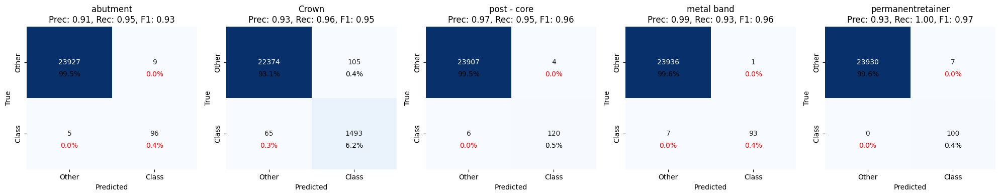

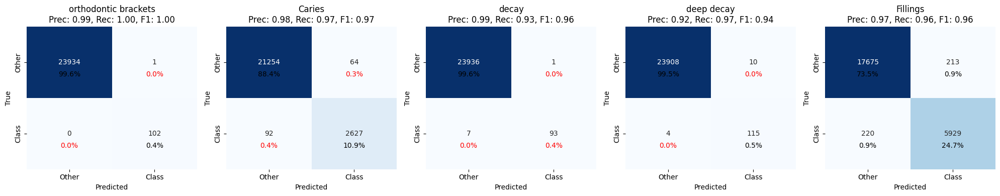

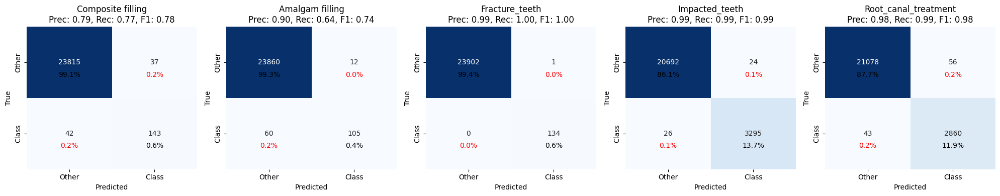

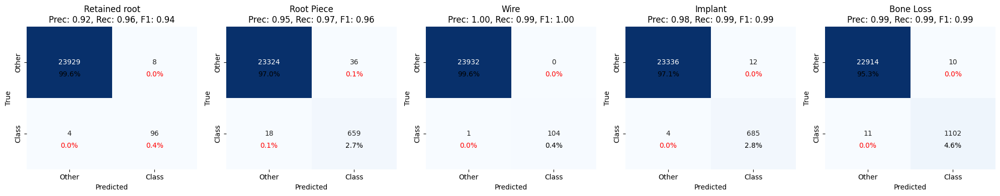

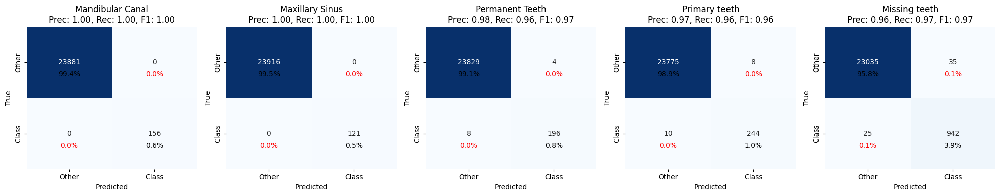

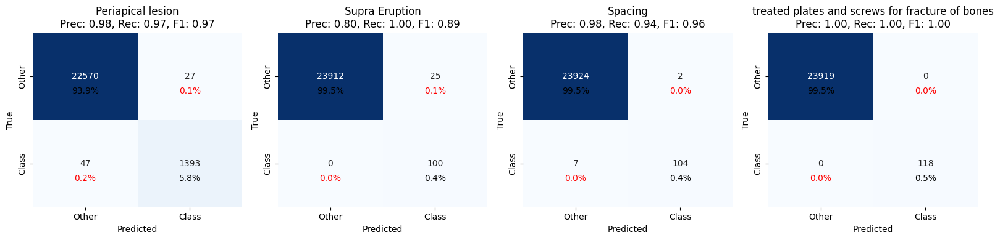


🔄 Analyzing classification errors...
❌ Testing failed: name 'plot_error_analysis' is not defined


Traceback (most recent call last):
  File "<ipython-input-5-631bfc50fe65>", line 461, in <cell line: 0>
    test_model(
  File "<ipython-input-5-631bfc50fe65>", line 437, in test_model
    plot_error_analysis(all_labels, all_preds, cat_id_to_name, idx_to_cat_id)
    ^^^^^^^^^^^^^^^^^^^
NameError: name 'plot_error_analysis' is not defined


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import json
import cv2
from collections import defaultdict
import os
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pickle
from tqdm import tqdm
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import random

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

class FocalLoss(nn.Module):
    """Focal Loss implementation for handling class imbalance"""
    def __init__(self, alpha=1, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction
        self.ce_loss = nn.CrossEntropyLoss(reduction='none')

    def forward(self, inputs, targets):
        ce_loss = self.ce_loss(inputs, targets)
        pt = torch.exp(-ce_loss)
        focal_loss = self.alpha * (1 - pt) ** self.gamma * ce_loss

        if self.reduction == 'mean':
            return torch.mean(focal_loss)
        elif self.reduction == 'sum':
            return torch.sum(focal_loss)
        else:
            return focal_loss

class DentalDataset(Dataset):
    """PyTorch Dataset for dental X-ray images"""
    def __init__(self, annotations, images_dir, transform=None, return_info=False):
        self.annotations = annotations
        self.images_dir = images_dir
        self.transform = transform
        self.return_info = return_info

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        ann = self.annotations[idx]

        # Load image
        img_path = os.path.join(self.images_dir, ann['img_file'])
        image = cv2.imread(img_path)
        original_image = image.copy() if image is not None else None

        if image is None:
            # Return a dummy image if loading fails
            image = np.zeros((224, 224, 3), dtype=np.uint8)
        else:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Crop with bounding box
            x, y, w, h = map(int, ann['bbox'])
            cropped = image[y:y+h, x:x+w]

            if cropped.size == 0:
                image = np.zeros((224, 224, 3), dtype=np.uint8)
            else:
                image = cv2.resize(cropped, (224, 224))

        # Apply transforms
        if self.transform:
            image = self.transform(image)

        # Convert label to tensor
        label = ann['label_idx']

        if self.return_info:
            return image, label, img_path, ann['bbox'], original_image
        else:
            return image, label

class EfficientNetV2Model(nn.Module):
    """EfficientNet V2 model for dental classification"""
    def __init__(self, num_classes):
        super(EfficientNetV2Model, self).__init__()

        # Load pretrained EfficientNet V2 Small
        self.efficientnet = models.efficientnet_v2_s(pretrained=True)

        # Freeze early layers
        for param in list(self.efficientnet.features.parameters())[:30]:
            param.requires_grad = False

        # Modify classifier
        num_ftrs = self.efficientnet.classifier[1].in_features
        self.efficientnet.classifier = nn.Sequential(
            nn.Dropout(0.2),
            nn.Linear(num_ftrs, num_classes)
        )

    def forward(self, x):
        return self.efficientnet(x)

def load_annotations(annotation_path):
    """Load annotations from JSON file"""
    with open(annotation_path, 'r') as f:
        data = json.load(f)

    # Create mappings
    cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
    img_id_to_file = {img['id']: img['file_name'] for img in data['images']}

    # Process annotations
    annotations = []
    for ann in data['annotations']:
        annotations.append({
            'img_file': img_id_to_file[ann['image_id']],
            'bbox': ann['bbox'],
            'category_id': ann['category_id']
        })

    return annotations, data['categories'], cat_id_to_name

def prepare_test_dataset(dataset_path, batch_size=16):
    """Prepare test dataset"""

    # Load annotations
    annotation_path = os.path.join(dataset_path, 'test', '_annotations.json')
    images_dir = os.path.join(dataset_path, 'test')

    # Check if test set exists, otherwise use validation from training data
    if not os.path.exists(annotation_path):
        annotation_path = os.path.join(dataset_path, 'train', '_annotations_augmented.json')
        images_dir = os.path.join(dataset_path, 'train')
        print("Test set not found, using validation split from training data")

    annotations, categories, cat_id_to_name = load_annotations(annotation_path)

    # Map category IDs to indices
    unique_cat_ids = sorted(set(ann['category_id'] for ann in annotations))
    cat_id_to_idx = {cat_id: idx for idx, cat_id in enumerate(unique_cat_ids)}
    num_classes = len(unique_cat_ids)

    # Update annotations with label indices
    for ann in annotations:
        ann['label_idx'] = cat_id_to_idx[ann['category_id']]

    # If using training data, split into test
    if 'test' not in annotation_path:
        _, test_anns = train_test_split(annotations, test_size=0.2, random_state=42,
                                       stratify=[ann['category_id'] for ann in annotations])
    else:
        test_anns = annotations

    # Define transforms
    test_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Create datasets
    test_dataset = DentalDataset(test_anns, images_dir, transform=test_transform, return_info=True)

    # Create dataloaders
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    return test_loader, num_classes, cat_id_to_idx, cat_id_to_name

def plot_per_class_confusion_matrix(y_true, y_pred, cat_id_to_name, idx_to_cat_id):
    """Plot confusion matrix for each class individually, 5 per figure"""

    # Get unique labels from both y_true and y_pred
    unique_labels = sorted(set(y_true) | set(y_pred))

    # Calculate overall confusion matrix with all possible labels
    cm = confusion_matrix(y_true, y_pred, labels=unique_labels)

    # Split into multiple figures, 5 classes per figure
    classes_per_fig = 5
    n_figures = (len(unique_labels) + classes_per_fig - 1) // classes_per_fig

    for fig_idx in range(n_figures):
        plt.figure(figsize=(20, 4))
        start_idx = fig_idx * classes_per_fig
        end_idx = min(start_idx + classes_per_fig, len(unique_labels))

        for i, label_idx in enumerate(unique_labels[start_idx:end_idx]):
            plt.subplot(1, classes_per_fig, i + 1)

            # Find position of this label in the confusion matrix
            label_pos = unique_labels.index(label_idx)

            # Extract 2x2 matrix for this class (binary classification: this class vs all others)
            true_positives = cm[label_pos, label_pos]
            false_positives = sum(cm[:, label_pos]) - true_positives
            false_negatives = sum(cm[label_pos, :]) - true_positives
            true_negatives = sum(sum(cm)) - true_positives - false_positives - false_negatives

            binary_cm = np.array([[true_negatives, false_positives],
                                  [false_negatives, true_positives]])

            # Calculate metrics
            precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
            recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
            f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

            # Get class name
            class_name = cat_id_to_name[idx_to_cat_id[label_idx]] if label_idx in idx_to_cat_id else f"Class {label_idx}"

            # Plot
            sns.heatmap(binary_cm, annot=True, fmt='d', cmap='Blues',
                        xticklabels=['Other', 'Class'],
                        yticklabels=['Other', 'Class'],
                        cbar=False)
            plt.xlabel('Predicted')
            plt.ylabel('True')
            plt.title(f'{class_name}\n'
                     f'Prec: {precision:.2f}, Rec: {recall:.2f}, F1: {f1:.2f}', fontsize=12)

            # Add percentages as annotation
            total = sum(sum(binary_cm))
            for y in range(2):
                for x in range(2):
                    plt.text(x + 0.5, y + 0.7, f'{100 * binary_cm[y, x] / total:.1f}%',
                            horizontalalignment='center',
                            color='red' if binary_cm[y, x] < 100 else 'black',
                            fontsize=10)

        plt.tight_layout()
        plt.savefig(f'individual_class_confusion_matrices_{fig_idx+1}.png', dpi=300, bbox_inches='tight')
        plt.show()  # Display the figure
        plt.close()

def plot_example_classes(y_true, y_pred, cat_id_to_name, idx_to_cat_id, n_classes=5):
    """Plot confusion matrices for n example classes in a single figure"""

    # Get unique labels from both y_true and y_pred
    unique_labels = sorted(set(y_true) | set(y_pred))[:n_classes]

    # Calculate overall confusion matrix with all possible labels
    all_labels = sorted(set(y_true) | set(y_pred))
    cm = confusion_matrix(y_true, y_pred, labels=all_labels)

    plt.figure(figsize=(20, 4))

    for i, label_idx in enumerate(unique_labels):
        plt.subplot(1, n_classes, i + 1)

        # Find position of this label in the confusion matrix
        label_pos = all_labels.index(label_idx)

        # Extract 2x2 matrix for this class (binary classification: this class vs all others)
        true_positives = cm[label_pos, label_pos]
        false_positives = sum(cm[:, label_pos]) - true_positives
        false_negatives = sum(cm[label_pos, :]) - true_positives
        true_negatives = sum(sum(cm)) - true_positives - false_positives - false_negatives

        binary_cm = np.array([[true_negatives, false_positives],
                              [false_negatives, true_positives]])

        # Calculate metrics
        precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
        recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Get class name
        class_name = cat_id_to_name[idx_to_cat_id[label_idx]] if label_idx in idx_to_cat_id else f"Class {label_idx}"

        # Plot
        sns.heatmap(binary_cm, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Not ' + class_name, class_name],
                    yticklabels=['Not ' + class_name, class_name],
                    cbar=False)
        plt.xlabel('Predicted', fontsize=12)
        plt.ylabel('True', fontsize=12)
        plt.title(f'{class_name}\n'
                 f'Precision: {precision:.2f}, Recall: {recall:.2f}, F1: {f1:.2f}', fontsize=12)

        # Add percentages as annotation
        total = sum(sum(binary_cm))
        for y in range(2):
            for x in range(2):
                plt.text(x + 0.5, y + 0.7, f'{100 * binary_cm[y, x] / total:.1f}%',
                        horizontalalignment='center',
                        color='red' if binary_cm[y, x] < 100 else 'black',
                        fontsize=10)

    plt.tight_layout()
    plt.savefig('example_individual_confusion_matrices.png', dpi=300, bbox_inches='tight')
    plt.show()  # Display the figure
    plt.close()

def visualize_predictions(model, test_loader, cat_id_to_name, idx_to_cat_id, device, num_samples=5):
    """Visualize sample predictions with bounding boxes for ground truth and predictions"""

    model.eval()

    # Get random samples
    sample_indices = random.sample(range(len(test_loader.dataset)), num_samples)

    plt.figure(figsize=(15, 5*num_samples))

    with torch.no_grad():
        for idx, sample_idx in enumerate(sample_indices):
            image, label, img_path, bbox, original_image = test_loader.dataset[sample_idx]

            # Skip if original image is None
            if original_image is None:
                continue

            # Get prediction
            input_tensor = image.unsqueeze(0).to(device)
            outputs = model(input_tensor)
            _, pred = torch.max(outputs, 1)
            pred_idx = pred.item()

            # Get class names
            true_class = cat_id_to_name[idx_to_cat_id[label]] if label in idx_to_cat_id else f"Class {label}"
            pred_class = cat_id_to_name[idx_to_cat_id[pred_idx]] if pred_idx in idx_to_cat_id else f"Class {pred_idx}"

            # Create visualization with ground truth
            plt.subplot(num_samples, 2, idx*2 + 1)
            img_with_gt = original_image.copy()
            x, y, w, h = map(int, bbox)
            cv2.rectangle(img_with_gt, (x, y), (x+w, y+h), (0, 255, 0), 3)
            cv2.putText(img_with_gt, f"GT: {true_class}", (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
            plt.imshow(cv2.cvtColor(img_with_gt, cv2.COLOR_BGR2RGB))
            plt.title('Ground Truth')
            plt.axis('off')

            # Create visualization with prediction
            plt.subplot(num_samples, 2, idx*2 + 2)
            img_with_pred = original_image.copy()
            color = (0, 255, 0) if pred_idx == label else (0, 0, 255)
            cv2.rectangle(img_with_pred, (x, y), (x+w, y+h), color, 3)
            cv2.putText(img_with_pred, f"Pred: {pred_class}", (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
            plt.imshow(cv2.cvtColor(img_with_pred, cv2.COLOR_BGR2RGB))
            plt.title('Prediction')
            plt.axis('off')

    plt.tight_layout()
    plt.savefig('prediction_comparison.png', dpi=300, bbox_inches='tight')
    plt.close()

def test_model(dataset_path, model_path, mapping_path, batch_size=16):
    """Comprehensive test function with all requested features"""

    print("🔄 Preparing test dataset...")
    test_loader, num_classes, cat_id_to_idx, cat_id_to_name = prepare_test_dataset(dataset_path, batch_size)
    idx_to_cat_id = {v: k for k, v in cat_id_to_idx.items()}

    # Load model
    print("🔄 Loading model...")
    model = EfficientNetV2Model(num_classes).to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Define criterion
    criterion = FocalLoss(gamma=2.0)

    # Evaluate on test set
    print("🔄 Evaluating on test set...")
    test_loss = 0.0
    test_corrects = 0
    total_samples = 0

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels, *_ in tqdm(test_loader, desc="Testing"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

            test_loss += loss.item() * inputs.size(0)
            test_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / total_samples
    test_acc = test_corrects.double() / total_samples

    print(f"\n📊 Test Results:")
    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {test_acc:.4f}")

    # Generate overall confusion matrix
    print("\n🔄 Generating overall confusion matrix...")
    unique_labels = sorted(set(all_labels) | set(all_preds))
    cm = confusion_matrix(all_labels, all_preds, labels=unique_labels)
    class_names = []
    for label in unique_labels:
        if label in idx_to_cat_id:
            class_names.append(cat_id_to_name[idx_to_cat_id[label]])
        else:
            class_names.append(f"Class {label}")

    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Overall Confusion Matrix - Test Set')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.savefig('test_confusion_matrix.png', dpi=300, bbox_inches='tight')
    plt.close()

    # Generate classification report
    print("\n📊 Classification Report:")
    print(classification_report(all_labels, all_preds, target_names=class_names, labels=unique_labels))

    # Generate individual class confusion matrices
    print("\n🔄 Generating individual class confusion matrices...")
    plot_per_class_confusion_matrix(all_labels, all_preds, cat_id_to_name, idx_to_cat_id)

    # Analyze classification errors
    print("\n🔄 Analyzing classification errors...")
    plot_error_analysis(all_labels, all_preds, cat_id_to_name, idx_to_cat_id)

    # Visualize sample predictions
    print("\n🔄 Visualizing sample predictions...")
    visualize_predictions(model, test_loader, cat_id_to_name, idx_to_cat_id, device)

    # Save test results
    test_results = {
        'test_loss': test_loss,
        'test_accuracy': test_acc,
        'predictions': all_preds,
        'labels': all_labels,
        'classification_report': classification_report(all_labels, all_preds, target_names=class_names, labels=unique_labels, output_dict=True)
    }

    with open('test_results.pkl', 'wb') as f:
        pickle.dump(test_results, f)

    print("\n✅ Testing completed successfully!")
    print(f"Final test accuracy: {test_acc:.4f}")

# Run testing
if __name__ == "__main__":
    try:
        test_model(
            dataset_path='/content/vzrad2-4',
            model_path='best_model.pth',
            mapping_path='category_mapping.pkl',
            batch_size=16
        )
    except Exception as e:
        print(f"❌ Testing failed: {str(e)}")
        import traceback
        traceback.print_exc()

## 📈 Performance Analysis with mAP :

This section calculates Mean Average Precision (mAP) and provides advanced evaluation metrics for object detection performance. The code is similar to the previous testing section but focuses on generating mAP calculations with minimal console output, making it ideal for direct result visualization and saving metrics without extensive printing.

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import json
import cv2
from collections import defaultdict
import os
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pickle
from tqdm import tqdm
from sklearn.metrics import confusion_matrix, classification_report, average_precision_score
import seaborn as sns
import random

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

class FocalLoss(nn.Module):
    """Focal Loss implementation for handling class imbalance"""
    def __init__(self, alpha=1, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction
        self.ce_loss = nn.CrossEntropyLoss(reduction='none')

    def forward(self, inputs, targets):
        ce_loss = self.ce_loss(inputs, targets)
        pt = torch.exp(-ce_loss)
        focal_loss = self.alpha * (1 - pt) ** self.gamma * ce_loss

        if self.reduction == 'mean':
            return torch.mean(focal_loss)
        elif self.reduction == 'sum':
            return torch.sum(focal_loss)
        else:
            return focal_loss

class DentalDataset(Dataset):
    """PyTorch Dataset for dental X-ray images"""
    def __init__(self, annotations, images_dir, transform=None, return_info=False):
        self.annotations = annotations
        self.images_dir = images_dir
        self.transform = transform
        self.return_info = return_info

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        ann = self.annotations[idx]

        # Load image
        img_path = os.path.join(self.images_dir, ann['img_file'])
        image = cv2.imread(img_path)
        original_image = image.copy() if image is not None else None

        if image is None:
            # Return a dummy image if loading fails
            image = np.zeros((224, 224, 3), dtype=np.uint8)
        else:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Crop with bounding box
            x, y, w, h = map(int, ann['bbox'])
            cropped = image[y:y+h, x:x+w]

            if cropped.size == 0:
                image = np.zeros((224, 224, 3), dtype=np.uint8)
            else:
                image = cv2.resize(cropped, (224, 224))

        # Apply transforms
        if self.transform:
            image = self.transform(image)

        # Convert label to tensor
        label = ann['label_idx']

        if self.return_info:
            return image, label, img_path, ann['bbox'], original_image
        else:
            return image, label

class EfficientNetV2Model(nn.Module):
    """EfficientNet V2 model for dental classification"""
    def __init__(self, num_classes):
        super(EfficientNetV2Model, self).__init__()

        # Load pretrained EfficientNet V2 Small
        self.efficientnet = models.efficientnet_v2_s(pretrained=True)

        # Freeze early layers
        for param in list(self.efficientnet.features.parameters())[:30]:
            param.requires_grad = False

        # Modify classifier
        num_ftrs = self.efficientnet.classifier[1].in_features
        self.efficientnet.classifier = nn.Sequential(
            nn.Dropout(0.2),
            nn.Linear(num_ftrs, num_classes)
        )

    def forward(self, x):
        return self.efficientnet(x)

def load_annotations(annotation_path):
    """Load annotations from JSON file"""
    with open(annotation_path, 'r') as f:
        data = json.load(f)

    # Create mappings
    cat_id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
    img_id_to_file = {img['id']: img['file_name'] for img in data['images']}

    # Process annotations
    annotations = []
    for ann in data['annotations']:
        annotations.append({
            'img_file': img_id_to_file[ann['image_id']],
            'bbox': ann['bbox'],
            'category_id': ann['category_id']
        })

    return annotations, data['categories'], cat_id_to_name

def prepare_test_dataset(dataset_path, batch_size=16):
    """Prepare test dataset"""

    # Load annotations
    annotation_path = os.path.join(dataset_path, 'test', '_annotations.json')
    images_dir = os.path.join(dataset_path, 'test')

    # Check if test set exists, otherwise use validation from training data
    if not os.path.exists(annotation_path):
        annotation_path = os.path.join(dataset_path, 'train', '_annotations_augmented.json')
        images_dir = os.path.join(dataset_path, 'train')
        print("Test set not found, using validation split from training data")

    annotations, categories, cat_id_to_name = load_annotations(annotation_path)

    # Map category IDs to indices
    unique_cat_ids = sorted(set(ann['category_id'] for ann in annotations))
    cat_id_to_idx = {cat_id: idx for idx, cat_id in enumerate(unique_cat_ids)}
    num_classes = len(unique_cat_ids)

    # Count samples per class
    class_counts = defaultdict(int)
    for ann in annotations:
        cat_id = ann['category_id']
        class_counts[cat_id] += 1

    # Print class distribution
    total_samples = len(annotations)
    print("Class distribution in test dataset:")
    for cat_id, count in class_counts.items():
        name = cat_id_to_name.get(cat_id, f"Unknown ({cat_id})")
        print(f"  {name}: {count} samples ({count/total_samples*100:.1f}%)")

    # Update annotations with label indices
    for ann in annotations:
        ann['label_idx'] = cat_id_to_idx[ann['category_id']]

    # If using training data, split into test
    if 'test' not in annotation_path:
        _, test_anns = train_test_split(annotations, test_size=0.2, random_state=42,
                                       stratify=[ann['category_id'] for ann in annotations])
    else:
        test_anns = annotations

    # Define transforms
    test_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Create datasets
    test_dataset = DentalDataset(test_anns, images_dir, transform=test_transform, return_info=True)

    # Create dataloaders
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    return test_loader, num_classes, cat_id_to_idx, cat_id_to_name

def plot_confusion_matrix(y_true, y_pred, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, phase="test"):
    """Plot confusion matrix for test data"""

    # Calculate confusion matrix
    unique_labels = sorted(set(y_true) | set(y_pred))
    cm = confusion_matrix(y_true, y_pred, labels=unique_labels)

    # Get class names
    class_names = []
    for label in unique_labels:
        if label in idx_to_cat_id:
            class_names.append(cat_id_to_name[idx_to_cat_id[label]])
        else:
            class_names.append(f"Class {label}")

    # Plot overall confusion matrix
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {phase.capitalize()}')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.savefig(f'{phase}_confusion_matrix.png', dpi=300, bbox_inches='tight')
    plt.close()

    # Calculate and plot per-class metrics
    classification_rep = classification_report(y_true, y_pred, target_names=class_names,
                                              labels=unique_labels, output_dict=True)

    # Plot individual class performance
    metrics = ['precision', 'recall', 'f1-score']

    plt.figure(figsize=(15, 5))

    # Create a bar chart for each metric
    for i, metric in enumerate(metrics):
        plt.subplot(1, 3, i+1)
        values = [classification_rep[class_name][metric] for class_name in class_names]
        sns.barplot(x=class_names, y=values)
        plt.title(f'{metric.capitalize()} by Class - {phase.capitalize()}')
        plt.xticks(rotation=45, ha='right')
        plt.ylim(0, 1)

    plt.tight_layout()
    plt.savefig(f'{phase}_class_metrics.png', dpi=300, bbox_inches='tight')
    plt.close()

    # Print classification report
    print(f"\n📊 {phase.capitalize()} Classification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names, labels=unique_labels))

    return classification_rep

def plot_per_class_confusion_matrix(y_true, y_pred, cat_id_to_name, idx_to_cat_id):
    """Plot confusion matrix for each class individually, 5 per figure"""

    # Get unique labels from both y_true and y_pred
    unique_labels = sorted(set(y_true) | set(y_pred))

    # Calculate overall confusion matrix with all possible labels
    cm = confusion_matrix(y_true, y_pred, labels=unique_labels)

    # Split into multiple figures, 5 classes per figure
    classes_per_fig = 5
    n_figures = (len(unique_labels) + classes_per_fig - 1) // classes_per_fig

    for fig_idx in range(n_figures):
        plt.figure(figsize=(20, 4))
        start_idx = fig_idx * classes_per_fig
        end_idx = min(start_idx + classes_per_fig, len(unique_labels))

        for i, label_idx in enumerate(unique_labels[start_idx:end_idx]):
            plt.subplot(1, classes_per_fig, i + 1)

            # Find position of this label in the confusion matrix
            label_pos = unique_labels.index(label_idx)

            # Extract 2x2 matrix for this class (binary classification: this class vs all others)
            true_positives = cm[label_pos, label_pos]
            false_positives = sum(cm[:, label_pos]) - true_positives
            false_negatives = sum(cm[label_pos, :]) - true_positives
            true_negatives = sum(sum(cm)) - true_positives - false_positives - false_negatives

            binary_cm = np.array([[true_negatives, false_positives],
                                  [false_negatives, true_positives]])

            # Calculate metrics
            precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
            recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
            f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

            # Get class name
            class_name = cat_id_to_name[idx_to_cat_id[label_idx]] if label_idx in idx_to_cat_id else f"Class {label_idx}"

            # Plot
            sns.heatmap(binary_cm, annot=True, fmt='d', cmap='Blues',
                        xticklabels=['Other', 'Class'],
                        yticklabels=['Other', 'Class'],
                        cbar=False)
            plt.xlabel('Predicted')
            plt.ylabel('True')
            plt.title(f'{class_name}\n'
                     f'Prec: {precision:.2f}, Rec: {recall:.2f}, F1: {f1:.2f}', fontsize=12)

            # Add percentages as annotation
            total = sum(sum(binary_cm))
            for y in range(2):
                for x in range(2):
                    plt.text(x + 0.5, y + 0.7, f'{100 * binary_cm[y, x] / total:.1f}%',
                            horizontalalignment='center',
                            color='red' if binary_cm[y, x] < 100 else 'black',
                            fontsize=10)

        plt.tight_layout()
        plt.savefig(f'individual_class_confusion_matrices_{fig_idx+1}.png', dpi=300, bbox_inches='tight')
        plt.close()

def plot_error_analysis(y_true, y_pred, cat_id_to_name, idx_to_cat_id):
    """Analyze and visualize classification errors"""
    from collections import Counter, defaultdict

    # Create a dictionary to store misclassifications
    error_dict = defaultdict(lambda: defaultdict(int))

    # Count misclassifications
    for true_label, pred_label in zip(y_true, y_pred):
        if true_label != pred_label:
            true_class = cat_id_to_name[idx_to_cat_id[true_label]] if true_label in idx_to_cat_id else f"Class {true_label}"
            pred_class = cat_id_to_name[idx_to_cat_id[pred_label]] if pred_label in idx_to_cat_id else f"Class {pred_label}"
            error_dict[true_class][pred_class] += 1

    # Find top 10 most frequent misclassifications
    error_counts = []
    for true_class, pred_dict in error_dict.items():
        for pred_class, count in pred_dict.items():
            error_counts.append((true_class, pred_class, count))

    # Sort errors by count in descending order
    top_errors = sorted(error_counts, key=lambda x: x[2], reverse=True)[:10]

    # Visualize top 10 misclassifications
    plt.figure(figsize=(12, 8))

    true_classes = [err[0] for err in top_errors]
    pred_classes = [err[1] for err in top_errors]
    counts = [err[2] for err in top_errors]

    # Create x positions
    x_pos = np.arange(len(top_errors))

    # Create bar chart
    bars = plt.barh(x_pos, counts, align='center', alpha=0.7)

    # Add count labels to the bars
    for i, bar in enumerate(bars):
        plt.text(bar.get_width() + 0.5, bar.get_y() + bar.get_height()/2,
                str(counts[i]), ha='left', va='center')

    # Add labels
    plt.yticks(x_pos, [f"{true} → {pred}" for true, pred in zip(true_classes, pred_classes)])
    plt.xlabel('Number of misclassifications')
    plt.title('Top 10 Most Frequent Misclassifications')

    plt.tight_layout()
    plt.savefig('top_misclassifications.png', dpi=300, bbox_inches='tight')
    plt.close()

    # Analyze most confused classes
    class_error_rate = defaultdict(lambda: {'total': 0, 'errors': 0})

    # Count total and error instances for each class
    for true_label, pred_label in zip(y_true, y_pred):
        true_class = cat_id_to_name[idx_to_cat_id[true_label]] if true_label in idx_to_cat_id else f"Class {true_label}"
        class_error_rate[true_class]['total'] += 1
        if true_label != pred_label:
            class_error_rate[true_class]['errors'] += 1

    # Calculate error rate for each class
    error_rates = []
    for class_name, counts in class_error_rate.items():
        if counts['total'] > 0:
            error_rate = counts['errors'] / counts['total']
            error_rates.append((class_name, error_rate, counts['total'], counts['errors']))

    # Sort by error rate in descending order
    top_error_rates = sorted(error_rates, key=lambda x: x[1], reverse=True)[:10]

    # Visualize classes with highest error rates
    plt.figure(figsize=(12, 8))

    classes = [err[0] for err in top_error_rates]
    rates = [err[1] for err in top_error_rates]
    totals = [err[2] for err in top_error_rates]

    # Create x positions
    x_pos = np.arange(len(top_error_rates))

    # Create bar chart
    bars = plt.barh(x_pos, rates, align='center', alpha=0.7)

    # Add percentage and count labels
    for i, bar in enumerate(bars):
        plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height()/2,
                f"{rates[i]:.2f} ({top_error_rates[i][3]}/{totals[i]})",
                ha='left', va='center')

    # Add labels
    plt.yticks(x_pos, classes)
    plt.xlabel('Error Rate')
    plt.title('Classes with Highest Error Rates')
    plt.xlim(0, max(rates) + 0.2)

    plt.tight_layout()
    plt.savefig('highest_error_rates.png', dpi=300, bbox_inches='tight')
    plt.close()

def calculate_map(y_true, y_pred, cat_id_to_name, idx_to_cat_id, outputs=None):
    """Calculate mean Average Precision (mAP)"""

    # If we have raw outputs, use them for AP calculation
    if outputs is not None:
        # Convert outputs to numpy array if needed
        if not isinstance(outputs, np.ndarray):
            outputs = np.array(outputs)

        # Number of classes
        num_classes = outputs.shape[1]

        # Convert labels to one-hot encoding
        y_true_one_hot = np.zeros((len(y_true), num_classes))
        for i, label in enumerate(y_true):
            y_true_one_hot[i, label] = 1

        # Calculate AP for each class
        ap_per_class = {}
        for cls_idx in range(num_classes):
            if np.sum(y_true_one_hot[:, cls_idx]) > 0:  # Only calculate if the class appears in ground truth
                class_ap = average_precision_score(y_true_one_hot[:, cls_idx], outputs[:, cls_idx])

                # Get class name
                if cls_idx in idx_to_cat_id:
                    class_name = cat_id_to_name[idx_to_cat_id[cls_idx]]
                else:
                    class_name = f"Class {cls_idx}"

                ap_per_class[class_name] = class_ap

        # Calculate mAP
        mAP = np.mean(list(ap_per_class.values()))

        # Print results
        print(f"\n📊 Mean Average Precision (mAP): {mAP:.4f}")

        # Print AP for each class
        print("\n📊 Average Precision per class:")
        for class_name, ap in sorted(ap_per_class.items(), key=lambda x: x[1], reverse=True):
            print(f"{class_name}: {ap:.4f}")

        # Visualize AP per class
        plt.figure(figsize=(12, 8))

        # Sort classes by AP
        sorted_ap = sorted(ap_per_class.items(), key=lambda x: x[1], reverse=True)
        classes = [item[0] for item in sorted_ap]
        aps = [item[1] for item in sorted_ap]

        # Create bar chart
        plt.bar(range(len(classes)), aps, align='center', alpha=0.7)

        # Add AP value labels
        for i, ap in enumerate(aps):
            plt.text(i, ap + 0.02, f"{ap:.3f}", ha='center', va='bottom', rotation=0)

        # Add labels
        plt.xticks(range(len(classes)), classes, rotation=45, ha='right')
        plt.ylabel('Average Precision')
        plt.title('Average Precision per Class')
        plt.ylim(0, 1.1)
        plt.grid(axis='y', linestyle='--', alpha=0.7)

        plt.tight_layout()
        plt.savefig('average_precision_per_class.png', dpi=300, bbox_inches='tight')
        plt.close()

        return mAP, ap_per_class
    else:
        # Without raw outputs, we can only approximate mAP using classification accuracy per class
        print("\n⚠️ Note: Raw model outputs not provided. Using class precision as approximation.")

        from sklearn.metrics import precision_recall_fscore_support

        # Calculate precision, recall, and f1-score per class
        precision, recall, f1, support = precision_recall_fscore_support(y_true, y_pred, average=None)

        # Get class names
        class_names = []
        unique_labels = sorted(set(y_true) | set(y_pred))
        for label in unique_labels:
            if label in idx_to_cat_id:
                class_names.append(cat_id_to_name[idx_to_cat_id[label]])
            else:
                class_names.append(f"Class {label}")

        # Calculate approximate mAP as average of precision scores
        mAP = np.mean(precision)

        # Create dictionary of class-wise precision
        ap_per_class = {class_name: prec for class_name, prec in zip(class_names, precision)}

        # Print results
        print(f"\n📊 Approximate Mean Average Precision (mAP): {mAP:.4f}")

        # Print precision for each class
        print("\n📊 Precision per class:")
        for class_name, prec in sorted(ap_per_class.items(), key=lambda x: x[1], reverse=True):
            print(f"{class_name}: {prec:.4f}")

        # Visualize precision per class
        plt.figure(figsize=(12, 8))

        # Sort classes by precision
        sorted_prec = sorted(zip(class_names, precision), key=lambda x: x[1], reverse=True)
        classes = [item[0] for item in sorted_prec]
        precs = [item[1] for item in sorted_prec]

        # Create bar chart
        plt.bar(range(len(classes)), precs, align='center', alpha=0.7)

        # Add precision value labels
        for i, prec in enumerate(precs):
            plt.text(i, prec + 0.02, f"{prec:.3f}", ha='center', va='bottom', rotation=0)

        # Add labels
        plt.xticks(range(len(classes)), classes, rotation=45, ha='right')
        plt.ylabel('Precision')
        plt.title('Precision per Class (mAP approximation)')
        plt.ylim(0, 1.1)
        plt.grid(axis='y', linestyle='--', alpha=0.7)

        plt.tight_layout()
        plt.savefig('precision_per_class.png', dpi=300, bbox_inches='tight')
        plt.close()

        return mAP, ap_per_class

def visualize_predictions(model, test_loader, cat_id_to_name, idx_to_cat_id, device, num_samples=5):
    """Visualize sample predictions with bounding boxes for ground truth and predictions"""

    model.eval()

    # Get random samples
    sample_indices = random.sample(range(len(test_loader.dataset)), num_samples)

    plt.figure(figsize=(15, 5*num_samples))

    with torch.no_grad():
        for idx, sample_idx in enumerate(sample_indices):
            image, label, img_path, bbox, original_image = test_loader.dataset[sample_idx]

            # Skip if original image is None
            if original_image is None:
                continue

            # Get prediction
            input_tensor = image.unsqueeze(0).to(device)
            outputs = model(input_tensor)
            _, pred = torch.max(outputs, 1)
            pred_idx = pred.item()

            # Get class names
            true_class = cat_id_to_name[idx_to_cat_id[label]] if label in idx_to_cat_id else f"Class {label}"
            pred_class = cat_id_to_name[idx_to_cat_id[pred_idx]] if pred_idx in idx_to_cat_id else f"Class {pred_idx}"

            # Create visualization with ground truth
            plt.subplot(num_samples, 2, idx*2 + 1)
            img_with_gt = original_image.copy()
            x, y, w, h = map(int, bbox)
            cv2.rectangle(img_with_gt, (x, y), (x+w, y+h), (0, 255, 0), 3)
            cv2.putText(img_with_gt, f"GT: {true_class}", (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
            plt.imshow(cv2.cvtColor(img_with_gt, cv2.COLOR_BGR2RGB))
            plt.title('Ground Truth')
            plt.axis('off')

            # Create visualization with prediction
            plt.subplot(num_samples, 2, idx*2 + 2)
            img_with_pred = original_image.copy()
            color = (0, 255, 0) if pred_idx == label else (0, 0, 255)
            cv2.rectangle(img_with_pred, (x, y), (x+w, y+h), color, 3)
            cv2.putText(img_with_pred, f"Pred: {pred_class}", (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2)
            plt.imshow(cv2.cvtColor(img_with_pred, cv2.COLOR_BGR2RGB))
            plt.title('Prediction')
            plt.axis('off')

    plt.tight_layout()
    plt.savefig('prediction_comparison.png', dpi=300, bbox_inches='tight')
    plt.close()

def test_model(dataset_path, model_path, mapping_path, batch_size=16):
    """Comprehensive test function with all requested features"""

    print("🔄 Preparing test dataset...")
    test_loader, num_classes, cat_id_to_idx, cat_id_to_name = prepare_test_dataset(dataset_path, batch_size)
    idx_to_cat_id = {v: k for k, v in cat_id_to_idx.items()}

    # Load model
    print("🔄 Loading model...")
    model = EfficientNetV2Model(num_classes).to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Define criterion
    criterion = FocalLoss(gamma=2.0)

    # Evaluate on test set
    print("🔄 Evaluating on test set...")
    test_loss = 0.0
    test_corrects = 0
    total_samples = 0

    all_preds = []
    all_labels = []
    all_outputs = []  # Store raw model outputs for mAP calculation

    with torch.no_grad():
        for inputs, labels, *_ in tqdm(test_loader, desc="Testing"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

            test_loss += loss.item() * inputs.size(0)
            test_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_outputs.extend(outputs.cpu().numpy())  # Store raw outputs

    test_loss = test_loss / total_samples
    test_acc = test_corrects.double() / total_samples

    print(f"\n📊 Test Results:")
    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {test_acc:.4f}")

    # Generate overall confusion matrix
    print("\n🔄 Generating overall confusion matrix...")
    plot_confusion_matrix(all_labels, all_preds, cat_id_to_name, cat_id_to_idx, idx_to_cat_id, "test")

    # Generate individual class confusion matrices
    print("\n🔄 Generating individual class confusion matrices...")
    plot_per_class_confusion_matrix(all_labels, all_preds, cat_id_to_name, idx_to_cat_id)

    # Analyze classification errors
    print("\n🔄 Analyzing classification errors...")
    plot_error_analysis(all_labels, all_preds, cat_id_to_name, idx_to_cat_id)

    # Calculate mean Average Precision (mAP)
    print("\n🔄 Calculating mean Average Precision (mAP)...")
    mAP, ap_per_class = calculate_map(all_labels, all_preds, cat_id_to_name, idx_to_cat_id, all_outputs)

    # Visualize sample predictions
    print("\n🔄 Visualizing sample predictions...")
    visualize_predictions(model, test_loader, cat_id_to_name, idx_to_cat_id, device)

    # Save test results
    test_results = {
        'test_loss': test_loss,
        'test_accuracy': test_acc,
        'predictions': all_preds,
        'labels': all_labels,
        'classification_report': classification_report(
            all_labels, all_preds,
            target_names=[cat_id_to_name[idx_to_cat_id[i]] if i in idx_to_cat_id else f"Class {i}"
                         for i in sorted(set(all_labels) | set(all_preds))],
            labels=sorted(set(all_labels) | set(all_preds)),
            output_dict=True
        ),
        'mAP': mAP,
        'ap_per_class': ap_per_class
    }

    with open('test_results.pkl', 'wb') as f:
        pickle.dump(test_results, f)

    print("\n✅ Testing completed successfully!")
    print(f"Final test accuracy: {test_acc:.4f}")
    print(f"Mean Average Precision (mAP): {mAP:.4f}")

# Run testing
if __name__ == "__main__":
    try:
        test_model(
            dataset_path='/content/vzrad2-4',
            model_path='best_model.pth',
            mapping_path='category_mapping.pkl',
            batch_size=16
        )
    except Exception as e:
        print(f"❌ Testing failed: {str(e)}")
        import traceback
        traceback.print_exc()

Using device: cuda
🔄 Preparing test dataset...
Test set not found, using validation split from training data
Class distribution in test dataset:
  Fillings: 30745 samples (25.6%)
  Crown: 7790 samples (6.5%)
  Root_canal_treatment: 14514 samples (12.1%)
  Mandibular Canal: 778 samples (0.6%)
  Maxillary Sinus: 604 samples (0.5%)
  Bone Loss: 5563 samples (4.6%)
  Impacted_teeth: 16608 samples (13.8%)
  Periapical lesion: 7199 samples (6.0%)
  Root Piece: 3387 samples (2.8%)
  Caries: 13594 samples (11.3%)
  Missing teeth: 4833 samples (4.0%)
  Implant: 3447 samples (2.9%)
  Composite filling: 926 samples (0.8%)
  Amalgam filling: 826 samples (0.7%)
  abutment: 504 samples (0.4%)
  post - core: 632 samples (0.5%)
  Primary teeth: 1269 samples (1.1%)
  Fracture_teeth: 670 samples (0.6%)
  orthodontic brackets: 508 samples (0.4%)
  deep decay: 594 samples (0.5%)
  Wire: 525 samples (0.4%)
  Permanent Teeth: 1022 samples (0.9%)
  Spacing: 557 samples (0.5%)
  decay: 500 samples (0.4%)
  tr

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_S_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_S_Weights.DEFAULT` to get the most up-to-date weights.


🔄 Evaluating on test set...


Testing: 100%|██████████| 1503/1503 [00:57<00:00, 25.98it/s]



📊 Test Results:
Test Loss: 0.0417
Test Accuracy: 0.9704

🔄 Generating overall confusion matrix...

📊 Test Classification Report:
                                                 precision    recall  f1-score   support

                                       abutment       0.91      0.95      0.93       101
                                          Crown       0.93      0.96      0.95      1558
                                    post - core       0.97      0.95      0.96       126
                                     metal band       0.99      0.93      0.96       100
                              permanentretainer       0.93      1.00      0.97       100
                           orthodontic brackets       0.99      1.00      1.00       102
                                         Caries       0.98      0.97      0.97      2719
                                          decay       0.99      0.93      0.96       100
                                     deep decay       0.92      0.97